# No data? No problem! Genera datasets sintéticos con Python

**PyCon España 2025 - Workshop (90 minutos)**

Este notebook guía el workshop práctico sobre generación de datos sintéticos con el SDK de MostlyAI.

**Instructor:** Felipe Calderero - Head of Software Engineering at Mostly AI  
**LinkedIn:** [linkedin.com/in/felipecalderero](https://www.linkedin.com/in/felipecalderero/)

---

⭐ **¿Te gusta este proyecto?** Dale una estrella en GitHub: [github.com/mostly-ai/mostlyai](https://github.com/mostly-ai/mostlyai)

---

## Objetivos del workshop:
- ✅ Entender el problema de reidentificación y por qué la anonimización tradicional no funciona
- ✅ Generar datos sintéticos realistas desde cero
- ✅ Evaluar la calidad y utilidad de los datos sintéticos
- ✅ Controlar el resultado con filtros y condiciones específicas  
- ✅ Crear conjuntos multitabla con relaciones entre entidades
- ✅ Trabajar con datos sin comprometer la privacidad

**Dataset**: US Census Income  
**SDK**: MostlyAI (open source)

---


## Flujo del Workshop

- **Configuración del entorno** (5 min)
  - ⚠️ Recomendado hacerlo antes del workshop

- **El Problema: Reidentificación** (10 min)
  - Demo de reidentificación en datos "anonimizados"
  - Por qué la anonimización tradicional no funciona

- **Fundamentos: Tu primer dataset sintético** (15 min)
  - Entrenar un generator (2 min)
  - Generar datos sintéticos
  - Comparar distribuciones
  - Verificar protección de privacidad

- **Evaluación: ¿Son buenos estos datos?** (10 min)
  - QA Report automático
  - TSTR (Train-on-Synthetic / Test-on-Real)

- **Control del resultado** (25 min)
  - Seeded generation (generación condicional)
  - Imputation inteligente
  - Rebalancing de clases
  - Fairness (equidad)

- **Datasets Multitabla con Relaciones** (20 min)
  - Crear estructura multitabla (3 tablas relacionadas)
  - Mantener integridad referencial
  - Análisis con JOINs

- **Wrap-up y próximos pasos** (5 min)

**Total:** 90 minutos


## 0. Configuración del Entorno


### Configuración Local

Esta sección te guía para configurar un entorno Python aislado para el tutorial. Usamos **uv**, una herramienta moderna que es mucho más rápida que `pip` + `venv` tradicional.

> **¿Por qué un entorno virtual?** Aísla las dependencias del proyecto para evitar conflictos con otras instalaciones de Python en tu sistema.

#### Paso 1: Instalar `uv`

**macOS / Linux:**
```bash
curl -LsSf https://astral.sh/uv/install.sh | sh
export PATH="$HOME/.local/bin:$PATH"
```

**Windows (PowerShell):**
```powershell
iwr https://astral.sh/uv/install.ps1 -UseBasicParsing | iex
```

**Verificar instalación:**
```bash
uv --version
```

#### Paso 2: Crear entorno virtual

```bash
cd /ruta/a/tu/proyecto
uv venv .pycon-mostlyai
```

#### Paso 3: Activar entorno virtual

**macOS / Linux:**
```bash
source .pycon-mostlyai/bin/activate
```

**Windows (PowerShell):**
```powershell
.\.pycon-mostlyai\Scripts\Activate.ps1
```

> **Indicador de éxito:** Deberías ver `(.pycon-mostlyai)` al inicio de tu prompt de terminal.

#### Paso 4: Instalar dependencias

```bash
uv pip install "pydantic<2.12" "mostlyai[local]" jupyter ipykernel scikit-learn
```

> **⚠️ Nota importante:** Es necesario instalar `pydantic<2.12` para evitar incompatibilidades. La versión 2.12.0 introduce cambios que causan errores con `mostlyai 5.2.7`.

> **¿Qué instala esto?**
> - `pydantic<2.12`: Biblioteca de validación (versión compatible)
> - `mostlyai[local]`: SDK de MostlyAI con todas las dependencias para modo local
> - `jupyter`: Para ejecutar notebooks
> - `ipykernel`: Para conectar el entorno con Jupyter
> - `scikit-learn`: Para los ejemplos de ML

#### Paso 5: Registrar como kernel de Jupyter

```bash
python -m ipykernel install --user --name pycon-mostlyai --display-name "Python (PyCon-MostlyAI)"
```

> **¿Por qué esto?** Permite que Jupyter use este entorno específico en lugar del Python del sistema.

#### Paso 6: Ejecutar Jupyter Lab

```bash
uv run jupyter lab
```

#### Verificación Final

1. **Jupyter Lab se abre** en tu navegador (generalmente en `http://localhost:8888`)
2. **Selecciona el kernel correcto:** En Jupyter, ve a **Kernel → Change Kernel → Python (PyCon-MostlyAI)**
3. **Prueba la importación:** Ejecuta la primera celda de código del notebook

#### 🔧 Troubleshooting

**Si ya tenías el entorno creado y `probe`/`generate` fallan con error `AttributeError: 'ValidationInfo' object has no attribute 'generator'`:**

```bash
source .pycon-mostlyai/bin/activate
uv pip install "pydantic<2.12" --force-reinstall
```

Luego reinicia el kernel de Jupyter: **Kernel → Restart Kernel**

#### Comandos útiles

```bash
# Desactivar entorno
deactivate

# Reactivar entorno
source .pycon-mostlyai/bin/activate

# Eliminar entorno completo (si quieres empezar de cero)
rm -rf .pycon-mostlyai
```

---

💡 **Tip para el workshop:** La configuración completa toma ~5 minutos. Recomendamos hacerla **antes** del workshop para aprovechar mejor el tiempo.


### En Google Colab:


In [79]:
%pip install -q --disable-pip-version-check "mostlyai[local]" scikit-learn


Note: you may need to restart the kernel to use updated packages.


### Imports y configuración inicial



In [80]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mostlyai.sdk import MostlyAI

plt.style.use('default')
plt.rcParams['figure.figsize'] = (12, 6)

mostly = MostlyAI(local=True)
np.random.seed(42)

print("✅ Setup completo!")


Initializing Synthetic Data SDK 5.3.1 in LOCAL mode 🏠

Connected to ]8;id=934976;file:///Users/felipe/mostlyai\/Users/felipe/]8;;\]8;id=581337;file:///Users/felipe/mostlyai\mostlyai]8;;\ with 36 GB RAM, 14 CPUs, 0 GPUs available

✅ Setup completo!


## 1. El Problema: Reidentificación (12 min)

### 🎯 Escenario
Trabajas en RRHH y necesitas compartir datos salariales con una consultora para un análisis de brecha salarial.

Eliminas los nombres y piensas: *"Ya está anonimizado"*

**¿Es suficiente?** 🤔


### Cargar el dataset Census


In [2]:
url = "https://github.com/mostly-ai/public-demo-data/raw/dev/census/census.csv.gz"
census = pd.read_csv(url)

print(f"Dataset: {census.shape[0]:,} registros, {census.shape[1]} columnas")
print(f"\nColumnas: {list(census.columns)}")
census.head()


Dataset: 48,842 registros, 15 columnas

Columnas: ['age', 'workclass', 'fnlwgt', 'education', 'education_num', 'marital_status', 'occupation', 'relationship', 'race', 'sex', 'capital_gain', 'capital_loss', 'hours_per_week', 'native_country', 'income']


,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


### ¿Qué es el dataset US Census Income?

El **US Census Income Dataset** (también conocido como "Adult" dataset) es un conjunto de datos extraído del censo estadounidense de 1994. Este dataset es ampliamente utilizado en machine learning para tareas de clasificación.

**Objetivo principal:** Predecir si una persona gana más o menos de $50,000 al año basándose en características demográficas, educativas y laborales.

**Características del dataset:**
- 📊 Aproximadamente 48,000 registros de personas adultas
- 🏛️ Fuente: US Census Bureau (1994)
- 🎯 Tarea: Clasificación binaria de nivel de ingresos
- 🔍 Uso común: Estudios de inequidad salarial, brecha de género, y análisis socioeconómico

**¿Por qué lo usamos en este workshop?**
- Es un dataset **realista** con información sensible (ingresos, demografía)
- Perfecto para demostrar **riesgos de reidentificación**
- Útil para mostrar cómo los **datos sintéticos preservan utilidad** para análisis de ML


### Descripción de las columnas

**Variables demográficas:**
- `age`: Edad de la persona
- `sex`: Género (Male/Female)
- `race`: Raza/etnia
- `native_country`: País de nacimiento

**Variables educativas:**
- `education`: Nivel educativo alcanzado (Bachelors, Masters, Doctorate, etc.)
- `education_num`: Nivel educativo codificado como número (mayor = más educación)

**Variables laborales:**
- `workclass`: Sector laboral (Private, Government, Self-employed, etc.)
- `occupation`: Tipo de ocupación (Tech-support, Craft-repair, Sales, etc.)
- `hours_per_week`: Horas trabajadas por semana

**Variables familiares:**
- `marital_status`: Estado civil (Married, Divorced, Single, etc.)
- `relationship`: Rol en la familia (Husband, Wife, Own-child, etc.)

**Variables financieras:**
- `capital_gain`: Ganancias de capital (inversiones, propiedades)
- `capital_loss`: Pérdidas de capital
- `fnlwgt`: Factor de peso en el muestreo del censo (representa cuántas personas del censo representa este registro)

**Variable objetivo:**
- `income`: Nivel de ingresos (>50K o <=50K por año)


In [3]:
census.describe()


,age,fnlwgt,education_num,capital_gain,capital_loss,hours_per_week
count,48842.000000,4.884200e+04,48842.000000,48842.000000,48842.000000,48842.000000
mean,38.643585,1.896641e+05,10.078089,1079.067626,87.502314,40.422382
std,13.710510,1.056040e+05,2.570973,7452.019058,403.004552,12.391444
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.175505e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.781445e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.376420e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.490400e+06,16.000000,99999.000000,4356.000000,99.000000


### Demo de Reidentificación

Imagina que conoces a alguien con estas características:
- Mujer
- PhD (Doctorado)
- Ejecutiva
- 49 años
- Gana >50K

**¿Podemos encontrarla en el dataset "anonimizado"?**


In [4]:
print("🔍 DEMO: REIDENTIFICACIÓN")
print("="*60)

candidatos = census[
    (census['sex'] == 'Female') &
    (census['education'] == 'Doctorate') &
    (census['age'] == 49) &
    (census['occupation'] == 'Exec-managerial') &
    (census['income'] == '>50K')
]

print(f"\nBuscando: Mujer, PhD, ejecutiva, 49 años, >50K")
print(f"Candidatos encontrados: {len(candidatos)}")

if len(candidatos) <= 3:
    print("\n⚠️  ¡FÁCILMENTE IDENTIFICABLE!")
    print("Con información pública (LinkedIn, redes) → identificación completa")
    if len(candidatos) > 0:
        print("\nEjemplo de registro identificable:")
        print(candidatos.iloc[0][['age', 'education', 'occupation', 'hours_per_week', 'income']])


🔍 DEMO: REIDENTIFICACIÓN

Buscando: Mujer, PhD, ejecutiva, 49 años, >50K
Candidatos encontrados: 1

⚠️  ¡FÁCILMENTE IDENTIFICABLE!
Con información pública (LinkedIn, redes) → identificación completa

Ejemplo de registro identificable:
age                            49
education               Doctorate
occupation        Exec-managerial
hours_per_week                 50
income                       >50K
Name: 28173, dtype: object


### 💡 Tu turno: Intenta reidentificar

**Tarea:** Piensa en un perfil que podría ser único y trata de encontrarlo en el dataset.

**Ideas de perfiles a buscar:**
- Hombre joven (20-25 años) con Doctorado trabajando en Tech-support
- Persona de >60 años con Masters trabajando muchas horas (>60 horas/semana)
- Alguien con alta educación pero ingresos bajos
- Persona de un país poco común (`native_country`) con características específicas

**Pistas para conseguir reidentificación:**
- Combina 3-4 características diferentes
- Usa valores "raros" o poco comunes
- Prueba con combinaciones que sean poco probables

**Objetivo:** Encontrar menos de 5 candidatos (idealmente 1-3) para demostrar el riesgo de reidentificación.

Usa la celda de abajo para tu código:


In [5]:
print("🔍 TU INTENTO DE REIDENTIFICACIÓN")
print("="*60)

mi_busqueda = census[
    (census['age'] > 0)
]

print(f"\nBuscando: [Describe tu búsqueda aquí]")
print(f"Candidatos encontrados: {len(mi_busqueda)}")

if len(mi_busqueda) <= 5:
    print("\n⚠️  ¡POTENCIALMENTE IDENTIFICABLE!")
    if len(mi_busqueda) > 0:
        print("\nPrimeros registros encontrados:")
        print(mi_busqueda.head())
else:
    print(f"\n❌ Demasiados candidatos. Intenta ser más específico.")
    print("💡 Tip: Añade más condiciones o usa características más raras")

print("\n" + "="*60)
print("💡 EJEMPLOS DE BÚSQUEDAS EFECTIVAS (descomenta para probar):")
print("="*60)

# EJEMPLO 1: Joven con doctorado en Tech-support
# ejemplo1 = census[
#     (census['age'] <= 25) &
#     (census['education'] == 'Doctorate') &
#     (census['occupation'] == 'Tech-support')
# ]
# print(f"\nEjemplo 1 - Joven con PhD en Tech: {len(ejemplo1)} candidatos")

# EJEMPLO 2: Persona mayor con muchas horas de trabajo
# ejemplo2 = census[
#     (census['age'] >= 65) &
#     (census['hours_per_week'] >= 60) &
#     (census['education'] == 'Masters')
# ]
# print(f"Ejemplo 2 - Mayor, Masters, +60 horas: {len(ejemplo2)} candidatos")

# EJEMPLO 3: País raro + educación alta
# ejemplo3 = census[
#     (census['native_country'] == 'Holand-Netherlands') &
#     (census['education'] == 'Doctorate')
# ]
# print(f"Ejemplo 3 - Holanda + PhD: {len(ejemplo3)} candidatos")


🔍 TU INTENTO DE REIDENTIFICACIÓN

Buscando: [Describe tu búsqueda aquí]
Candidatos encontrados: 48842

❌ Demasiados candidatos. Intenta ser más específico.
💡 Tip: Añade más condiciones o usa características más raras

💡 EJEMPLOS DE BÚSQUEDAS EFECTIVAS (descomenta para probar):


### Análisis de riesgo general


In [6]:
print("📊 ANÁLISIS DE RIESGO GENERAL")
print("="*60)

combos = census.groupby(['sex', 'education', 'occupation', 'age']).size()
unicos = combos[combos == 1]

print(f"\nCombinaciones únicas: {len(unicos):,} de {len(census):,}")
print(f"Porcentaje de registros únicos: {len(unicos)/len(census)*100:.1f}%")

print("\n🚨 CONCLUSIÓN:")
print("   • Miles de personas son identificables con solo 4 características")
print("   • Anonimización tradicional NO funciona")
print("   • Necesitamos una solución mejor: DATOS SINTÉTICOS")


📊 ANÁLISIS DE RIESGO GENERAL

Combinaciones únicas: 3,799 de 48,842
Porcentaje de registros únicos: 7.8%

🚨 CONCLUSIÓN:
   • Miles de personas son identificables con solo 4 características
   • Anonimización tradicional NO funciona
   • Necesitamos una solución mejor: DATOS SINTÉTICOS


### Casos reales de reidentificación

**Ejemplos históricos:**

- **AOL Search Data (2006)**: 650,000 usuarios "anonimizados" → periodistas identificaron individuos por sus búsquedas
  - 📰 [New York Times: A Face Is Exposed for AOL Searcher No. 4417749](https://www.nytimes.com/2006/08/09/technology/09aol.html)
  - 📰 [Wikipedia: AOL search data leak](https://en.wikipedia.org/wiki/AOL_search_data_leak)

- **Netflix Prize (2007)**: Dataset "anonimizado" → investigadores reidentificaron usuarios cruzando con IMDB
  - 📄 [Paper original: Robust De-anonymization of Large Sparse Datasets](https://www.cs.cornell.edu/~shmat/shmat_oak08netflix.pdf)
  - 📰 [The Atlantic: How Netflix Reverse Engineered Hollywood](https://www.theatlantic.com/technology/archive/2014/01/how-netflix-reverse-engineered-hollywood/282679/)

- **NYC Taxi Data (2014)**: Viajes "anonimizados" → identificaron celebridades y sus destinos
  - 📰 [Neustar: Riding with the Stars](http://content.research.neustar.biz/blog/differential-privacy/QueriesWidget.html)
  - 📰 [Bradley Cooper's taxi ride: a lesson in privacy risk](https://www.heliossalinger.com.au/2015/04/19/bradley-coopers-taxi-ride-a-lesson-in-privacy-risk/)

**La solución: Datos Sintéticos**
- ✅ Privacidad real (no contienen información de personas reales)
- ✅ Utilidad preservada (mantienen patrones estadísticos)
- ✅ Sin riesgo de reidentificación
- ✅ Compartibles libremente

---

## 2. Fundamentos: Tu primer dataset sintético (18 min)

Vamos a generar una versión sintética del Census dataset que:
1. Preserve las distribuciones estadísticas
2. No contenga información de personas reales
3. Sea útil para análisis y ML

### Preparar los datos

In [7]:
from sklearn.model_selection import train_test_split

census_sample = census.sample(5000, random_state=42)

train_data, holdout_data = train_test_split(
    census_sample, 
    test_size=0.2, 
    random_state=42,
    stratify=census_sample['income']
)

print(f"Training: {len(train_data):,} registros")
print(f"Holdout: {len(holdout_data):,} registros")

Training: 4,000 registros
Holdout: 1,000 registros


### Entrenar el generator

#### ¿Qué es un Generator?

Un **generator** es un modelo de machine learning (basado en redes neuronales) que aprende la distribución de probabilidad de los datos originales. Piensa en él como un "experto" que:

1. 🧠 **Estudia** los patrones, correlaciones y distribuciones del dataset real
2. 🎨 **Aprende** las relaciones complejas entre variables (ej: "personas con PhD suelen ganar >50K")
3. 🎲 **Genera** nuevos registros que siguen esos mismos patrones, pero sin copiar personas reales

**Analogía:** Es como un chef que:
- Estudia una receta (datos originales)
- Entiende las proporciones y combinaciones (patrones estadísticos)
- Crea nuevos platos que tienen el mismo estilo, pero no son copias exactas (datos sintéticos)

**Tecnología subyacente:** MostlyAI usa **TabularARGN**, un modelo autoregresivo especializado en datos tabulares que genera cada columna condicionalmente basándose en las anteriores. Este enfoque permite capturar relaciones complejas entre variables de forma eficiente.

📄 **Paper del SDK:** [Democratizing Tabular Data Access with an Open-Source Synthetic-Data SDK](https://arxiv.org/html/2508.00718v1)

#### Configuración del Generator

Vamos a configurar y entrenar nuestro primer generator. Veamos qué significa cada parámetro:

**Estructura de la configuración:**

```python
config = {
    'name': 'Census Income Generator',           # Nombre descriptivo del generator
    'tables': [{                                  # Lista de tablas a sintetizar
        'name': 'census',                         # Nombre de la tabla
        'data': train_data,                       # DataFrame con los datos de entrenamiento
        'tabular_model_configuration': {          # Configuración del modelo
            'max_training_time': 2                # Tiempo máximo de entrenamiento (minutos)
        }
    }]
}
```

> **💡 Value Protection:** MostlyAI incluye protección de valores raros **por defecto**. No necesitas configurarlo explícitamente - el generator automáticamente detecta y protege valores que aparecen pocas veces (como países raros, ocupaciones únicas, etc.)

**Parámetros clave:**

- **`name`**: Identificador del generator (útil cuando tienes múltiples generators)
- **`tables`**: Lista de tablas a sintetizar (veremos multitabla más adelante)
- **`data`**: Los datos de entrenamiento (pandas DataFrame)
- **`max_training_time`**: Tiempo de entrenamiento en minutos
  - 🏎️ Valores pequeños (1-2 min): Rápido, bueno para pruebas y workshops
  - ⚖️ Valores medios (5-15 min): Balance entre velocidad y calidad
  - 🎯 Valores altos (30+ min): Mejor calidad, para producción

**Nota:** Para este workshop usamos 2 minutos para mantenerlo ágil, pero en producción recomendamos al menos 15-30 minutos.


In [8]:
config = {
    'name': 'Census Income Generator',
    'tables': [{
        'name': 'census',
        'data': train_data,
        'tabular_model_configuration': {
            'max_training_time': 2
        }
    }]
}

print("🚀 Entrenando generator...")
print("(Esto puede tardar unos minutos)\n")
print("💡 Nota: MostlyAI incluye value protection por defecto")
print("   (valores raros se protegen automáticamente)\n")

g = mostly.train(config=config)

print("\n✅ Generator entrenado!")

🚀 Entrenando generator...
(Esto puede tardar unos minutos)

💡 Nota: MostlyAI incluye value protection por defecto
   (valores raros se protegen automáticamente)



Created generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started generator training

Output()

🎉 Your generator is ready! Use it to create synthetic data. Publish it so others can do the same.


✅ Generator entrenado!


---

#### 💾 Checkpoint: Guardar el generator (opcional)

Si quieres guardar el generator entrenado para usarlo más tarde:

```python
# Guardar el generator
# mostly.save(g, 'census_generator.pkl')

# Cargar más tarde (si necesitas retomar el trabajo)
# g = mostly.load('census_generator.pkl')
```

Esto es útil si necesitas pausar el workshop y continuar después.


---

#### 🔧 Avanzado: Parámetros completos de configuración

Esta sección es **opcional** y está dirigida a usuarios que quieren personalizar más el entrenamiento del generator.

**Estructura completa de configuración:**

```python
config_avanzado = {
    'name': 'Mi Generator Personalizado',
    'tables': [{
        'name': 'mi_tabla',
        'data': mi_dataframe,
        
        # === CONFIGURACIÓN DE COLUMNAS ===
        'columns': [
            {
                'name': 'columna1',
                'model_encoding': 'CATEGORICAL',  # CATEGORICAL, NUMERIC, TEXT, DATETIME
                'encoding_precision': 0.99        # Precisión de encoding (0-1)
            }
        ],
        
        # === CLAVES E INTEGRIDAD REFERENCIAL ===
        'keys': [
            {
                'column': 'id',
                'reference': {                    # Para foreign keys
                    'table': 'otra_tabla',
                    'column': 'id'
                }
            }
        ],
        
        # === CONFIGURACIÓN DEL MODELO ===
        'tabular_model_configuration': {
            'max_training_time': 30,              # Tiempo máximo (minutos)
            'epochs': 256,                        # Número de epochs (auto si no se especifica)
            'batch_size': 512,                    # Tamaño del batch
            
            # Privacidad
            'dp': True,                           # Activar differential privacy
            'dp_epsilon': 1.0,                    # Epsilon para DP (menor = más privacidad)
            'dp_delta': 1e-5,                     # Delta para DP
            
            # Regularización
            'regularization_strength': 0.1        # Fuerza de regularización (0-1)
        },
        
        # === COLUMNAS CONTEXTUALES ===
        'context_columns': ['region', 'year']     # Columnas que condicionan la generación
    }]
}
```

**Parámetros detallados:**

**A) Configuración de columnas (`columns`):**
- **`model_encoding`**: Tipo de encoding para la columna
  - `CATEGORICAL`: Para variables categóricas (sex, education, etc.)
  - `NUMERIC`: Para variables numéricas (age, income, etc.)
  - `TEXT`: Para texto libre (requiere LLM finetuning)
  - `DATETIME`: Para fechas y timestamps
- **`encoding_precision`**: Precisión del encoding (0-1). Valores más altos = más precisión pero más memoria

> **🔐 Value Protection:** MostlyAI incluye protección automática de valores raros por defecto. Los valores que aparecen pocas veces (threshold configurable) se protegen automáticamente para evitar reidentificación. Ejemplo: Si solo 2 personas son de "Holand-Netherlands", el generator puede sustituirlo por un país similar o más común.

**B) Claves e integridad (`keys`):**
- **`column`**: Nombre de la columna clave
- **`reference`**: Para foreign keys, referencia a otra tabla (veremos en multitabla)

**C) Configuración del modelo (`tabular_model_configuration`):**

**Entrenamiento:**
- **`max_training_time`**: Tiempo máximo en minutos (default: 15)
- **`epochs`**: Número de epochs (auto-calculado si no se especifica)
- **`batch_size`**: Tamaño del batch (default: 512)

**Privacidad (Differential Privacy):**
- **`dp`**: Activar DP (default: False)
- **`dp_epsilon`**: ε (epsilon) - Budget de privacidad
  - Valores más bajos = más privacidad, menos utilidad
  - Típico: 0.1 - 10.0
- **`dp_delta`**: δ (delta) - Probabilidad de fallo
  - Típico: 1e-5 o menor

**Regularización:**
- **`regularization_strength`**: Fuerza de regularización (0-1)
  - Ayuda a prevenir overfitting
  - Default: auto-calculado

**D) Columnas contextuales (`context_columns`):**
- Columnas que se usan para condicionar la generación
- Útil para datos con estructura jerárquica o temporal
- Ejemplo: generar datos por región o por año

**💡 Recomendaciones:**

1. **Para empezar**: Usa solo `max_training_time` y deja el resto en auto
2. **Para producción**: Aumenta `max_training_time` a 30-60 minutos
3. **Para datos sensibles**: Activa `dp` con `dp_epsilon` entre 1-10
4. **Para datos desbalanceados**: Usa `regularization_strength` más alto (0.2-0.5)

**📚 Documentación completa:** [docs.mostly.ai](https://docs.mostly.ai)


### Generar datos sintéticos

Una vez entrenado el generator, podemos usarlo para crear nuevos datos sintéticos. Hay dos formas principales:

#### 🔬 Probe: Vista rápida

Un **probe** es una muestra pequeña de datos sintéticos (típicamente 5-10 registros) que se genera rápidamente para:
- ✅ Verificar que el generator funciona correctamente
- ✅ Inspeccionar visualmente la calidad de los datos
- ✅ Hacer pruebas rápidas sin esperar

**Uso:**
```python
probe = mostly.probe(g, size=5)  # Genera 5 registros de muestra
```

#### 🎲 Generate: Dataset completo

**Generate** crea el dataset sintético completo que usarás para análisis, ML, etc. Este proceso:
- 📊 Genera tantos registros como necesites (o el mismo tamaño que los datos originales)
- 🔗 Mantiene todas las correlaciones y patrones aprendidos
- ✨ Crea datos completamente nuevos (no copias)
- ⏱️ Puede tardar más tiempo según el tamaño

**Uso:**
```python
syn_dataset = mostly.generate(g)  # Genera dataset del mismo tamaño que el original
syn_data = syn_dataset.data()     # Extrae el DataFrame
```

Vamos a probar ambos:

In [9]:
probe = mostly.probe(g, size=5)
print("🔬 Probe (5 registros sintéticos):")
probe


🔬 Probe (5 registros sintéticos):


,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,35,Private,238536,HS-grad,9,Divorced,Machine-op-inspct,Unmarried,White,Female,0,0,40,United-States,<=50K
1,34,Private,290424,Some-college,10,Never-married,Sales,Not-in-family,White,Male,0,0,40,United-States,<=50K
2,18,?,27819,HS-grad,9,Never-married,?,Own-child,White,Male,0,0,40,United-States,<=50K
3,51,Private,46831,Some-college,10,Divorced,Other-service,Other-relative,Black,Female,0,0,38,United-States,<=50K
4,22,Private,292736,HS-grad,9,Separated,Craft-repair,Not-in-family,White,Male,0,0,40,United-States,<=50K


In [10]:
print("🎲 Generando dataset sintético completo...")
print(f"(Mismo tamaño que el entrenamiento: {len(train_data):,} registros)\n")

syn_dataset = mostly.generate(g)
syn_data = syn_dataset.data()

print(f"✅ Generado: {syn_data.shape[0]:,} registros, {syn_data.shape[1]} columnas")
print("\n🔬 Primeros registros sintéticos:")
syn_data.head()

🎲 Generando dataset sintético completo...
(Mismo tamaño que el entrenamiento: 4,000 registros)



Created synthetic dataset af56be66-37d4-49de-9ea4-16417a5e4663 with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

✅ Generado: 4,000 registros, 15 columnas

🔬 Primeros registros sintéticos:


,age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income
0,18,?,239986,11th,7,Never-married,?,Own-child,White,Male,0,0,12,United-States,<=50K
1,48,Private,175457,9th,5,Never-married,Other-service,Not-in-family,White,Female,0,0,30,United-States,<=50K
2,52,Private,322020,HS-grad,9,Never-married,Protective-serv,Not-in-family,White,Male,0,0,40,United-States,>50K
3,47,Private,282717,Some-college,10,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,42,United-States,>50K
4,28,Private,156848,Some-college,10,Divorced,Craft-repair,Not-in-family,White,Male,0,0,45,United-States,<=50K


### Verificación de Value Protection


In [11]:
print("🔐 VERIFICACIÓN: Value Protection automática\n")
print("="*60)

rare_countries_original = train_data['native_country'].value_counts()
rare_countries_original = rare_countries_original[rare_countries_original < 5]

print(f"\n📊 Países RAROS en datos originales (aparecen <5 veces):")
print(f"   Total de países raros: {len(rare_countries_original)}")
if len(rare_countries_original) > 0:
    print(f"\n   Ejemplos:")
    for country, count in rare_countries_original.head(5).items():
        print(f"      • {country}: {count} persona(s)")

rare_countries_synthetic = syn_data['native_country'].value_counts()
overlap = set(rare_countries_original.index) & set(rare_countries_synthetic.index)

print(f"\n📊 ¿Estos países raros aparecen en los SINTÉTICOS?")
print(f"   • Países raros que coinciden: {len(overlap)} de {len(rare_countries_original)}")

if len(overlap) > 0:
    print(f"\n   📌 Algunos valores raros aparecen en los sintéticos")
    print(f"      Esto puede ocurrir cuando:")
    print(f"      • El valor tiene suficiente representación en el dataset")
    print(f"      • Se combina con otros atributos que aumentan la diversidad")
else:
    print(f"\n   ✅ ¡Ningún país raro se copió exactamente!")
    print(f"   Los valores raros fueron sustituidos por países más comunes")

print(f"\n💡 ¿Qué es Value Protection?")
print(f"   • MostlyAI detecta automáticamente valores raros o únicos")
print(f"   • Estos valores se protegen para evitar reidentificación")
print(f"   • La distribución geográfica general se mantiene")
print(f"   • Los datos siguen siendo útiles para análisis")
print(f"\n   Ejemplo: Si solo 2 personas son de 'Holand-Netherlands',")
print(f"   este valor raro podría sustituirse por un país similar o más común")


🔐 VERIFICACIÓN: Value Protection automática


📊 Países RAROS en datos originales (aparecen <5 veces):
   Total de países raros: 15

   Ejemplos:
      • Trinadad&Tobago: 4 persona(s)
      • Italy: 4 persona(s)
      • Ecuador: 3 persona(s)
      • Iran: 3 persona(s)
      • Hong: 3 persona(s)

📊 ¿Estos países raros aparecen en los SINTÉTICOS?
   • Países raros que coinciden: 0 de 15

   ✅ ¡Ningún país raro se copió exactamente!
   Los valores raros fueron sustituidos por países más comunes

💡 ¿Qué es Value Protection?
   • MostlyAI detecta automáticamente valores raros o únicos
   • Estos valores se protegen para evitar reidentificación
   • La distribución geográfica general se mantiene
   • Los datos siguen siendo útiles para análisis

   Ejemplo: Si solo 2 personas son de 'Holand-Netherlands',
   este valor raro podría sustituirse por un país similar o más común


---

#### 🔧 Avanzado: Parámetros de generación

Esta sección es **opcional** y muestra todas las opciones disponibles para controlar la generación de datos sintéticos.

**Estructura básica de generate():**

```python
syn_dataset = mostly.generate(
    generator=g,              # El generator entrenado
    size=10000,               # Número de registros a generar
    seed=None,                # DataFrame seed para generación condicional
    config=None               # Configuración adicional
)
```

**Parámetros principales:**

**A) `size` (int):**
- Número de registros sintéticos a generar
- Puede ser mayor, menor o igual al dataset original
- No hay límite teórico (depende de recursos)

**B) `seed` (DataFrame, opcional):**
- DataFrame con valores pre-definidos para algunas columnas
- El generator "completa" las columnas faltantes
- **Uso:** Generación condicional (veremos más adelante)
- Ejemplo:
  ```python
  seed = pd.DataFrame({'sex': ['Female'] * 100, 'education': ['Doctorate'] * 100})
  syn = mostly.generate(g, seed=seed)
  ```

**C) `config` (dict, opcional):**
- Configuración avanzada de la generación
- Permite rebalancing, imputation, fairness, etc.

**Estructura completa de config:**

```python
config_avanzado = {
    'tables': [{
        'name': 'census',          # Nombre de la tabla a generar
        
        # === REBALANCING ===
        'configuration': {
            'rebalancing': {
                'column': 'income',  # Columna a rebalancear
                'probabilities': {
                    '>50K': 0.5,       # Probabilidad: 50% con >50K
                    '<=50K': 0.5       # Probabilidad: 50% con <=50K
                }
            },
            
            # === IMPUTATION ===
            'imputation': {
                'columns': ['education', 'occupation']  # Columnas a imputar
            },
            
            # === FAIRNESS ===
            'fairness': {
                'target_column': 'income',
                'sensitive_columns': ['sex', 'race']
            }
        }
    }]
}

syn_dataset = mostly.generate(g, size=10000, config=config_avanzado)
```

**Parámetros de configuración detallados:**

**1. Rebalancing:**
- **Objetivo:** Ajustar distribuciones de clases
- **Uso común:** Balancear clases minoritarias para ML
- **Ejemplo:**
  ```python
  config = {
      'tables': [{
          'configuration': {
              'rebalancing': {
                  'column': 'income',
                  'probabilities': {'>50K': 0.5, '<=50K': 0.5}
              }
          }
      }]
  }
  ```

**2. Imputation:**
- **Objetivo:** Rellenar valores faltantes de forma inteligente
- **Uso común:** Completar datos incompletos
- **Ejemplo:**
  ```python
  config = {
      'tables': [{
          'configuration': {
              'imputation': {'columns': ['education']}
          }
      }]
  }
  ```

**3. Fairness:**
- **Objetivo:** Generar datos con paridad estadística entre grupos
- **Uso común:** Reducir bias en datos de entrenamiento
- **Parámetros:**
  - `target_column`: Variable objetivo (la que queremos que sea equitativa)
  - `sensitive_columns`: Columnas sensibles (sex, race, etc.)

**💡 Casos de uso comunes:**

| Caso de Uso | Parámetro | Ejemplo |
|-------------|-----------|---------|
| Aumentar datos | `size` | `size=50000` (más que original) |
| Generación condicional | `seed` | Mujeres con PhD solamente |
| Balancear clases | `rebalancing` | 50-50 entre >50K y <=50K |
| Completar datos | `imputation` | Rellenar educación faltante |
| Reducir bias | `fairness` | Paridad entre géneros |

**📚 Más información:**
- [Documentación de generate()](https://docs.mostly.ai)
- Veremos ejemplos prácticos de seed, rebalancing e imputation en las siguientes secciones


### Comparar distribuciones: Real vs Sintético

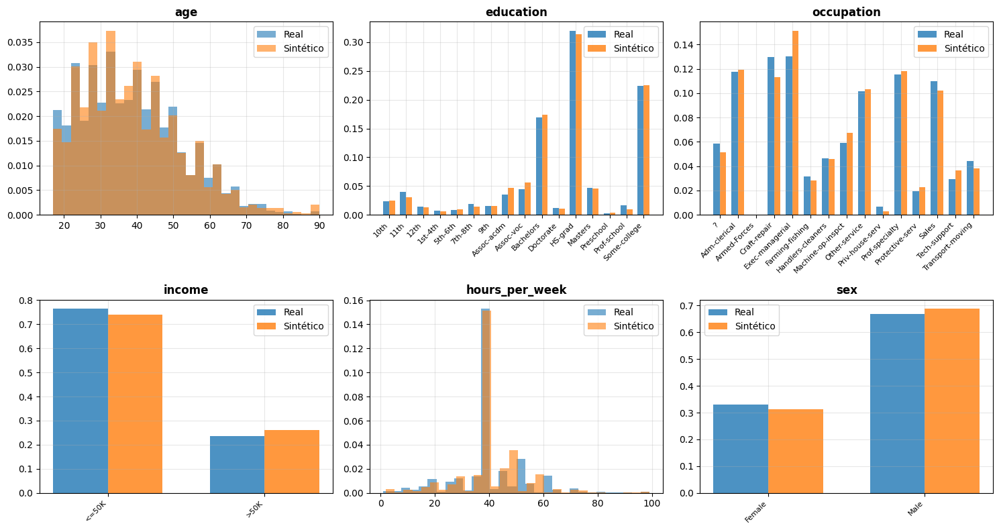

📊 Las distribuciones se preservan!


In [12]:
fig, axes = plt.subplots(2, 3, figsize=(15, 8))
axes = axes.ravel()

cols_to_plot = ['age', 'education', 'occupation', 'income', 'hours_per_week', 'sex']

for idx, col in enumerate(cols_to_plot):
    ax = axes[idx]
    
    if train_data[col].dtype == 'object' or train_data[col].nunique() < 10:
        real_counts = train_data[col].value_counts(normalize=True).sort_index()
        syn_counts = syn_data[col].value_counts(normalize=True).sort_index()
        
        all_categories = sorted(set(real_counts.index) | set(syn_counts.index))
        real_counts = real_counts.reindex(all_categories, fill_value=0)
        syn_counts = syn_counts.reindex(all_categories, fill_value=0)
        
        x = np.arange(len(all_categories))
        width = 0.35
        
        ax.bar(x - width/2, real_counts.values, width, label='Real', alpha=0.8)
        ax.bar(x + width/2, syn_counts.values, width, label='Sintético', alpha=0.8)
        ax.set_xticks(x)
        ax.set_xticklabels(all_categories, rotation=45, ha='right', fontsize=8)
    else:
        ax.hist(train_data[col].dropna(), bins=30, alpha=0.6, label='Real', density=True)
        ax.hist(syn_data[col].dropna(), bins=30, alpha=0.6, label='Sintético', density=True)
    
    ax.set_title(col, fontweight='bold')
    ax.legend()
    ax.grid(alpha=0.3)

plt.tight_layout()
plt.show()

print("📊 Las distribuciones se preservan!")

### Verificar: ¿Funciona la reidentificación en datos sintéticos?

**Aclaración importante sobre "combinaciones únicas":**

Cuando veas que los datos sintéticos tienen un % de combinaciones únicas, eso **NO es un problema de privacidad**. Aquí está la diferencia clave:

**❌ Datos "anonimizados" tradicionales (RIESGO):**
- Si hay 1 persona con una combinación única → ESA PERSONA REAL es identificable
- Ejemplo: Solo hay 1 mujer de 49 años con PhD ejecutiva → ¡La puedo encontrar con LinkedIn!

**✅ Datos sintéticos (SIN RIESGO):**
- Si hay 1 registro con combinación única → Es una PERSONA FICTICIA (no existe)
- El riesgo real se mide por: ¿Cuántas personas REALES únicas también aparecen en los sintéticos?
- Incluso si aparecen, no sabrías distinguir cuáles son reales y cuáles ficticias

**Métricas correctas de privacidad:**
1. **DCR (Distance to Closest Record)**: ¿Qué tan cerca están los sintéticos de los reales?
2. **Overlap de combinaciones únicas**: ¿Cuántas personas únicas REALES se pueden identificar?
3. **Memorización**: ¿Los sintéticos copian registros reales exactos?

Veamos esto en acción:


In [14]:
print("🔍 VERIFICACIÓN: Reidentificación en datos SINTÉTICOS")
print("="*60)

candidatos_syn = syn_data[
    (syn_data['sex'] == 'Female') &
    (syn_data['education'] == 'Doctorate') &
    (syn_data['age'] >= 45) & (syn_data['age'] <= 50) &
    (syn_data['occupation'] == 'Exec-managerial') &
    (syn_data['income'] == '>50K')
]

print(f"\n📊 PARTE 1: ¿Se pueden reidentificar personas REALES?")
print(f"   • Candidatos en datos REALES: {len(candidatos)}")
print(f"   • Candidatos en datos SINTÉTICOS: {len(candidatos_syn)}")

combos_syn = syn_data.groupby(['sex', 'education', 'occupation', 'age']).size()
unicos_syn = combos_syn[combos_syn == 1]

print(f"\n📊 PARTE 2: Combinaciones únicas")
print(f"   • En REALES: {len(unicos):,} de {len(train_data):,} ({len(unicos)/len(train_data)*100:.1f}%)")
print(f"   • En SINTÉTICOS: {len(unicos_syn):,} de {len(syn_data):,} ({len(unicos_syn)/len(syn_data)*100:.1f}%)")

combos_reales_set = set(train_data[(train_data['sex'].notna()) & (train_data['education'].notna()) & 
                                    (train_data['occupation'].notna()) & (train_data['age'].notna())].
                         apply(lambda x: (x['sex'], x['education'], x['occupation'], x['age']), axis=1))
combos_syn_set = set(syn_data[(syn_data['sex'].notna()) & (syn_data['education'].notna()) & 
                               (syn_data['occupation'].notna()) & (syn_data['age'].notna())].
                     apply(lambda x: (x['sex'], x['education'], x['occupation'], x['age']), axis=1))

unicos_reales_set = set(train_data[train_data.groupby(['sex', 'education', 'occupation', 'age'])['age'].transform('size') == 1].
                        apply(lambda x: (x['sex'], x['education'], x['occupation'], x['age']), axis=1))
unicos_reales_en_syn = unicos_reales_set & combos_syn_set

print(f"\n📊 PARTE 3: ¿Riesgo REAL de reidentificación? (LA MÉTRICA CLAVE)")
print(f"   • Combinaciones únicas REALES que también aparecen en SINTÉTICOS: {len(unicos_reales_en_syn):,}")
print(f"   • Porcentaje de combinaciones que coinciden: {len(unicos_reales_en_syn)/len(unicos)*100:.2f}%")

print(f"\n💡 EXPLICACIÓN CLAVE:")
print(f"   • Los datos SINTÉTICOS son personas FICTICIAS (no existen en la realidad)")
print(f"   • Aunque {len(unicos_reales_en_syn)/len(unicos)*100:.2f}% de combinaciones únicas coincidan,")
print(f"     NO puedes saber CUÁLES son reales y cuáles ficticias (efecto k-anonimato)")
print(f"   • Es como encontrar una aguja en un pajar, pero sin saber si la aguja es real o falsa")
print(f"   • Además: el resto de atributos (income, hours, etc.) son diferentes → no hay match exacto")

print(f"\n🔐 ¿Por qué es seguro?")
print(f"   1. Plausible deniability: Las combinaciones podrían ser reales o sintéticas")
print(f"   2. No hay registros exactos copiados (diferentes atributos complementarios)")
print(f"   3. El generator aprende PATRONES, no memoriza individuos")

print("\n✅ CONCLUSIÓN: Los datos sintéticos PROTEGEN contra reidentificación!")

🔍 VERIFICACIÓN: Reidentificación en datos SINTÉTICOS

📊 PARTE 1: ¿Se pueden reidentificar personas REALES?
   • Candidatos en datos REALES: 1
   • Candidatos en datos SINTÉTICOS: 0

📊 PARTE 2: Combinaciones únicas
   • En REALES: 3,799 de 4,000 (95.0%)
   • En SINTÉTICOS: 1,762 de 4,000 (44.0%)

📊 PARTE 3: ¿Riesgo REAL de reidentificación? (LA MÉTRICA CLAVE)
   • Combinaciones únicas REALES que también aparecen en SINTÉTICOS: 543
   • Porcentaje de combinaciones que coinciden: 14.29%

💡 EXPLICACIÓN CLAVE:
   • Los datos SINTÉTICOS son personas FICTICIAS (no existen en la realidad)
   • Aunque 14.29% de combinaciones únicas coincidan,
     NO puedes saber CUÁLES son reales y cuáles ficticias (efecto k-anonimato)
   • Es como encontrar una aguja en un pajar, pero sin saber si la aguja es real o falsa
   • Además: el resto de atributos (income, hours, etc.) son diferentes → no hay match exacto

🔐 ¿Por qué es seguro?
   1. Plausible deniability: Las combinaciones podrían ser reales o sinté

---

## 3. Evaluación: ¿Son buenos estos datos? (12 min)

Dos formas de evaluar calidad:
1. **QA Report**: Métricas automáticas de fidelidad
2. **TSTR**: Train-on-Synthetic / Test-on-Real

### QA Report automático

📊 Quality Assurance Report:




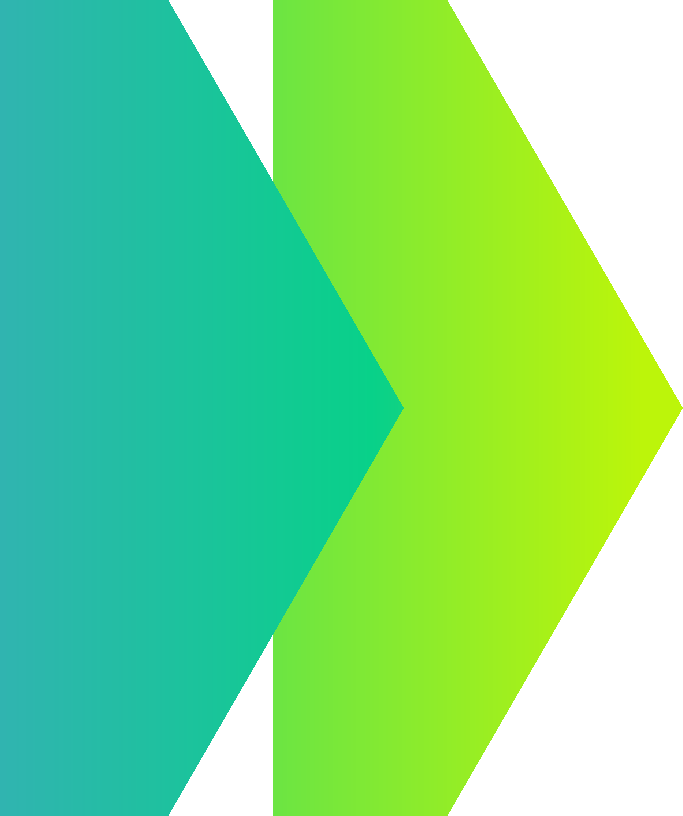
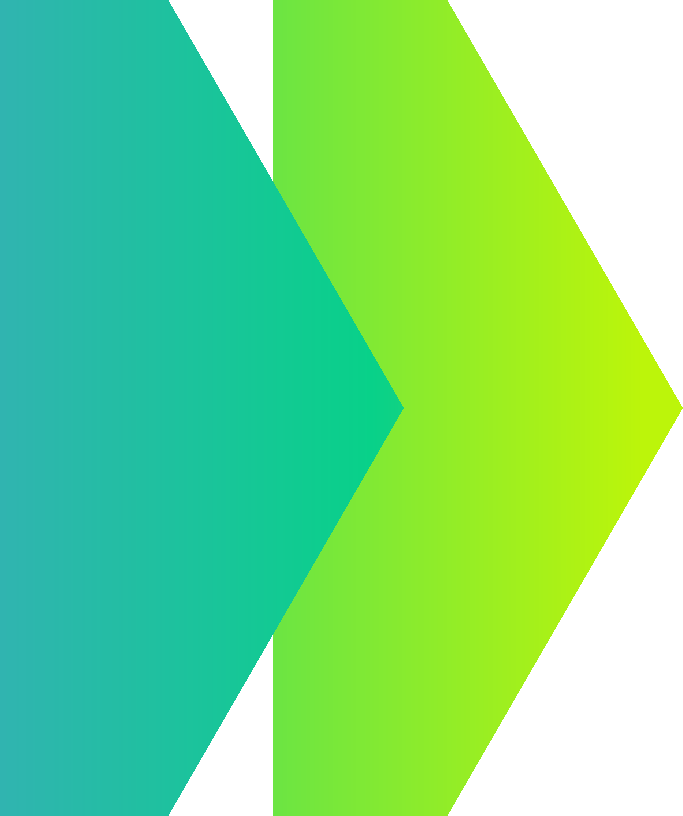
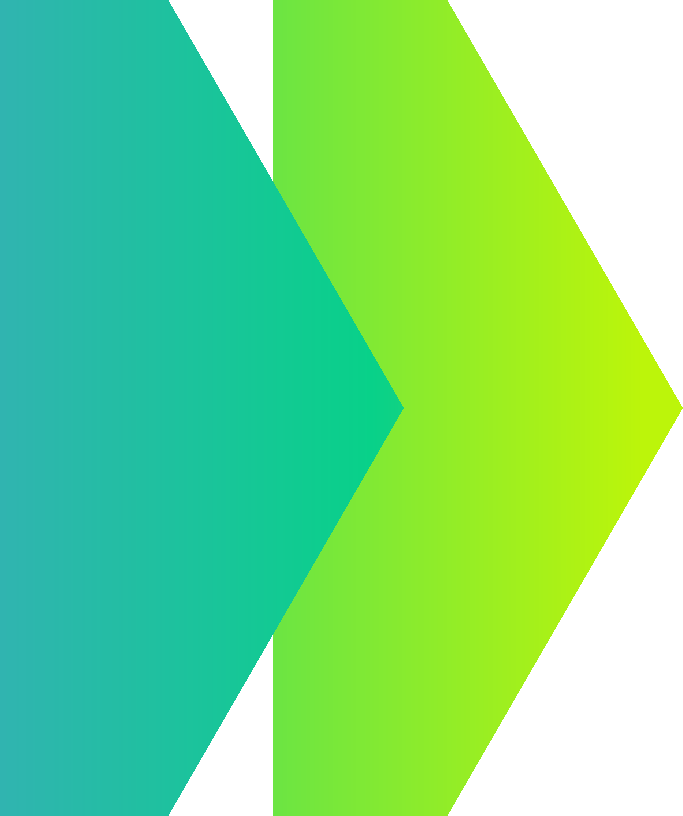

In [15]:
print("📊 Quality Assurance Report:\n")
g.reports(display=True)

**Métricas del QA Report:**

- **Accuracy**: Compara distribuciones univariadas y bivariadas
- **Similarity**: Compara embeddings de orden superior (patrones complejos)
- **Distance**: DCR (Distance to Closest Record) - mide novelty

### TSTR: Train-on-Synthetic / Test-on-Real

**Pregunta**: ¿Puedo entrenar un modelo con datos sintéticos y que funcione en datos reales?

**Tarea**: Predecir income (>50K vs <=50K)

In [16]:
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report

numeric_cols = ['age', 'capital_gain', 'capital_loss', 'hours_per_week', 'fnlwgt']
categorical_cols = ['workclass', 'education', 'marital_status', 'occupation', 
                    'relationship', 'race', 'sex', 'native_country']

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)
    ]
)

def evaluate_tstr(train_df, test_df, label):
    train_clean = train_df.dropna()
    test_clean = test_df.dropna()
    
    X_train = train_clean.drop(columns=['income'])
    y_train = train_clean['income']
    
    X_test = test_clean.drop(columns=['income'])
    y_test = test_clean['income']
    
    clf = Pipeline([
        ('preprocessor', preprocessor),
        ('classifier', LogisticRegression(max_iter=500))
    ])
    
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    
    print(f"\n{'='*60}")
    print(f"{label}")
    print(f"{'='*60}")
    print(classification_report(y_test, y_pred, digits=3))
    
    return classification_report(y_test, y_pred, output_dict=True)

report_tstr = evaluate_tstr(syn_data, holdout_data, "TSTR: Train-on-Synthetic / Test-on-Real")
report_real = evaluate_tstr(train_data, holdout_data, "Baseline: Train-on-Real / Test-on-Real")


TSTR: Train-on-Synthetic / Test-on-Real
              precision    recall  f1-score   support

       <=50K      0.863     0.903     0.882       764
        >50K      0.630     0.534     0.578       236

    accuracy                          0.816      1000
   macro avg      0.746     0.719     0.730      1000
weighted avg      0.808     0.816     0.811      1000


Baseline: Train-on-Real / Test-on-Real
              precision    recall  f1-score   support

       <=50K      0.873     0.907     0.890       764
        >50K      0.655     0.572     0.611       236

    accuracy                          0.828      1000
   macro avg      0.764     0.740     0.750      1000
weighted avg      0.821     0.828     0.824      1000



### Comparación visual

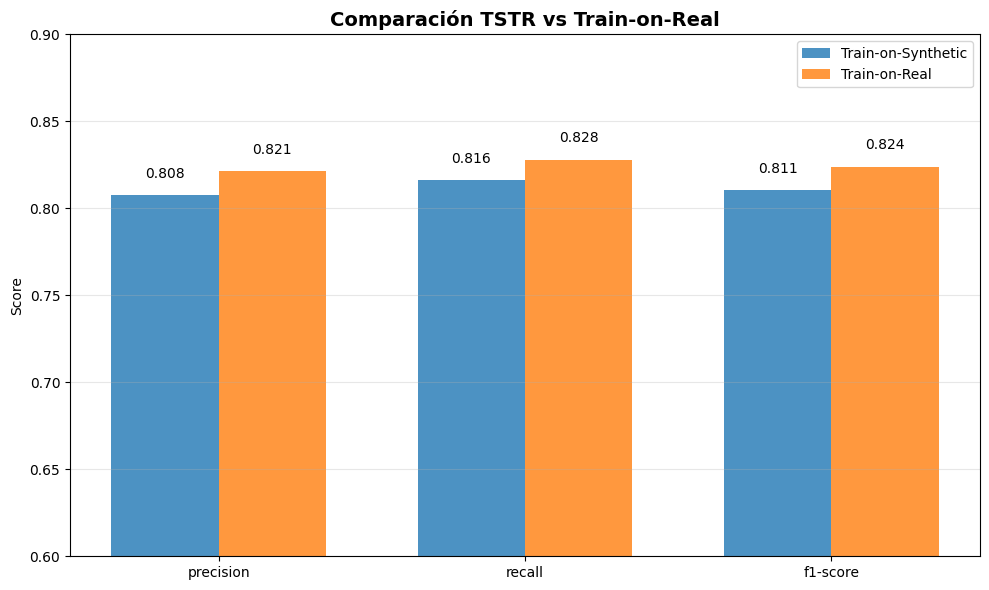


✅ Los datos sintéticos son útiles para ML!


In [17]:
metrics = ['precision', 'recall', 'f1-score']
tstr_scores = [report_tstr['weighted avg'][m] for m in metrics]
real_scores = [report_real['weighted avg'][m] for m in metrics]

x = np.arange(len(metrics))
width = 0.35

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(x - width/2, tstr_scores, width, label='Train-on-Synthetic', alpha=0.8)
ax.bar(x + width/2, real_scores, width, label='Train-on-Real', alpha=0.8)

ax.set_ylabel('Score')
ax.set_title('Comparación TSTR vs Train-on-Real', fontweight='bold', fontsize=14)
ax.set_xticks(x)
ax.set_xticklabels(metrics)
ax.set_ylim(0.6, 0.9)
ax.legend()
ax.grid(axis='y', alpha=0.3)

for i, (tstr, real) in enumerate(zip(tstr_scores, real_scores)):
    ax.text(i - width/2, tstr + 0.01, f'{tstr:.3f}', ha='center', fontsize=10)
    ax.text(i + width/2, real + 0.01, f'{real:.3f}', ha='center', fontsize=10)

plt.tight_layout()
plt.show()

print("\n✅ Los datos sintéticos son útiles para ML!")

---

## 4. Control del resultado: Filtros y condiciones (20 min)

Ahora que sabemos generar datos sintéticos, vamos a controlar QUÉ generamos.

### A. Seeded Generation (Generación Condicional)

**Caso de uso**: Quiero generar solo mujeres con PhD

**Cómo funciona**: Fijamos algunas columnas, el generator "completa" el resto manteniendo coherencia.

In [18]:
print("🎯 SEEDED GENERATION: Solo mujeres con PhD\n")

seed_women_phd = pd.DataFrame({
    'sex': ['Female'] * 20,
    'education': ['Doctorate'] * 20
})

print("Seed data (lo que fijamos):")
print(seed_women_phd.head())

syn_conditional = mostly.generate(g, seed=seed_women_phd)
syn_women_phd = syn_conditional.data()

print("\nDatos sintéticos generados (el generator completó el resto):")
print(syn_women_phd[['sex', 'education', 'age', 'occupation', 'income', 'hours_per_week']].head(10))

print(f"\n✅ Verificación:")
print(f"   • Todas mujeres: {(syn_women_phd['sex'] == 'Female').all()}")
print(f"   • Todas PhD: {(syn_women_phd['education'] == 'Doctorate').all()}")
print(f"   • Ocupaciones variadas: {syn_women_phd['occupation'].nunique()} diferentes")
print(f"   • Edades variadas: {syn_women_phd['age'].min():.0f} - {syn_women_phd['age'].max():.0f} años")

🎯 SEEDED GENERATION: Solo mujeres con PhD

Seed data (lo que fijamos):
      sex  education
0  Female  Doctorate
1  Female  Doctorate
2  Female  Doctorate
3  Female  Doctorate
4  Female  Doctorate


Created synthetic dataset 854a3fd8-922b-41f0-bd5b-a3297d6aeb99 with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.


Datos sintéticos generados (el generator completó el resto):
      sex  education  age       occupation income  hours_per_week
0  Female  Doctorate   58   Prof-specialty   >50K              40
1  Female  Doctorate   42   Prof-specialty   >50K              68
2  Female  Doctorate   53            Sales  <=50K              40
3  Female  Doctorate   25     Adm-clerical   >50K              33
4  Female  Doctorate   44  Exec-managerial  <=50K              40
5  Female  Doctorate   45   Prof-specialty  <=50K              45
6  Female  Doctorate   48   Prof-specialty   >50K              50
7  Female  Doctorate   40                ?  <=50K              40
8  Female  Doctorate   31   Prof-specialty   >50K              16
9  Female  Doctorate   20     Tech-support  <=50K              30

✅ Verificación:
   • Todas mujeres: True
   • Todas PhD: True
   • Ocupaciones variadas: 7 diferentes
   • Edades variadas: 20 - 58 años


### Ejemplo 2: Generar personas jóvenes con altos ingresos

In [19]:
print("🎯 SEEDED GENERATION: Jóvenes con altos ingresos\n")

seed_young_rich = pd.DataFrame({
    'age': [25, 26, 27, 28, 29, 30] * 5,
    'income': ['>50K'] * 30
})

syn_young_rich = mostly.generate(g, seed=seed_young_rich).data()

print("Datos sintéticos generados:")
print(syn_young_rich[['age', 'income', 'education', 'occupation', 'hours_per_week']].head(10))

print(f"\n📊 Distribución de educación en jóvenes con >50K:")
print(syn_young_rich['education'].value_counts())

🎯 SEEDED GENERATION: Jóvenes con altos ingresos



Created synthetic dataset dc9cb91d-0198-410b-88a4-e17ecb1628e4 with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

Datos sintéticos generados:
   age income     education         occupation  hours_per_week
0   25   >50K     Bachelors     Prof-specialty              30
1   26   >50K          11th       Craft-repair              25
2   27   >50K       HS-grad              Sales              50
3   28   >50K     Bachelors     Prof-specialty              30
4   29   >50K  Some-college    Exec-managerial              40
5   30   >50K     Bachelors              Sales              50
6   25   >50K  Some-college    Exec-managerial              60
7   26   >50K     Bachelors    Exec-managerial              40
8   27   >50K     Bachelors              Sales              40
9   28   >50K       HS-grad  Machine-op-inspct              65

📊 Distribución de educación en jóvenes con >50K:
education
Bachelors       10
HS-grad          9
Some-college     5
11th             1
Assoc-acdm       1
10th             1
Masters          1
Assoc-voc        1
Preschool        1
Name: count, dtype: Int64


### 💡 Momento interactivo

**¿Qué otras condiciones queréis probar?**

Ideas:
- Solo personas con Masters trabajando en Tech
- Personas mayores de 60 años
- Personas con ingresos bajos pero alta educación

Probad vosotros:

In [20]:
# Tu turno: crea tu propia seed data
# Prueba alguna de estas ideas o crea la tuya:

# IDEA 1: Solo personas con Masters trabajando en Tech
# my_seed = pd.DataFrame({
#     'education': ['Masters'] * 20,
#     'occupation': ['Tech-support'] * 20
# })

# IDEA 2: Personas mayores de 60 años
# my_seed = pd.DataFrame({
#     'age': list(range(60, 80))
# })

# IDEA 3: Personas con ingresos bajos pero alta educación (explorar la paradoja)
# my_seed = pd.DataFrame({
#     'education': ['Doctorate', 'Masters', 'Prof-school'] * 10,
#     'income': ['<=50K'] * 30
# })

# Genera y visualiza
# syn_custom = mostly.generate(g, seed=my_seed).data()
# print(syn_custom[['age', 'education', 'occupation', 'income', 'hours_per_week']].head(10))

### B. Imputation Inteligente

**Caso de uso**: Tengo datos con valores faltantes en `education`

**Solución**: El generator imputa valores coherentes basándose en el resto de características

In [22]:
print("🔧 IMPUTATION: Completar valores faltantes\n")

data_with_missing = train_data[train_data['education'].isnull()].copy()

if len(data_with_missing) == 0:
    print("No hay valores faltantes en education. Creando algunos artificialmente...")
    data_with_missing = train_data.sample(50, random_state=42).copy()

print(f"Registros originales: {len(data_with_missing)}")
print("\nEjemplo de datos CON education (antes de eliminarla para imputation):")
print(data_with_missing[['age', 'occupation', 'education', 'income']].head())

seed_for_imputation = data_with_missing.drop(columns=['education'])

print("\nSeed para imputation (SIN la columna education):")
print(seed_for_imputation[['age', 'occupation', 'income']].head())

imputation_config = {
    'tables': [{
        'name': 'census',
        'configuration': {
            'imputation': {'columns': ['education']}
        }
    }]
}

syn_imputed = mostly.generate(g, config=imputation_config, seed=seed_for_imputation).data()

print("\n✅ Datos con education imputada:")
print(syn_imputed[['age', 'occupation', 'education', 'income']].head())

print(f"\nValores faltantes después de imputation: {syn_imputed['education'].isnull().sum()}")

🔧 IMPUTATION: Completar valores faltantes

No hay valores faltantes en education. Creando algunos artificialmente...
Registros originales: 50

Ejemplo de datos CON education (antes de eliminarla para imputation):
       age       occupation     education income
46370   34     Craft-repair          12th  <=50K
22494   49     Craft-repair  Some-college  <=50K
14934   33            Sales     Assoc-voc  <=50K
29688   26  Exec-managerial       HS-grad   >50K
10660   52    Other-service  Some-college  <=50K

Seed para imputation (SIN la columna education):
       age       occupation income
46370   34     Craft-repair  <=50K
22494   49     Craft-repair  <=50K
14934   33            Sales  <=50K
29688   26  Exec-managerial   >50K
10660   52    Other-service  <=50K


Created synthetic dataset 001fa68f-f77b-4a14-b914-a22937155fce with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.


✅ Datos con education imputada:
   age       occupation     education income
0   34     Craft-repair          12th  <=50K
1   49     Craft-repair  Some-college  <=50K
2   33            Sales     Assoc-voc  <=50K
3   26  Exec-managerial       HS-grad   >50K
4   52    Other-service  Some-college  <=50K

Valores faltantes después de imputation: 0


### Comparación: Imputation inteligente vs naive

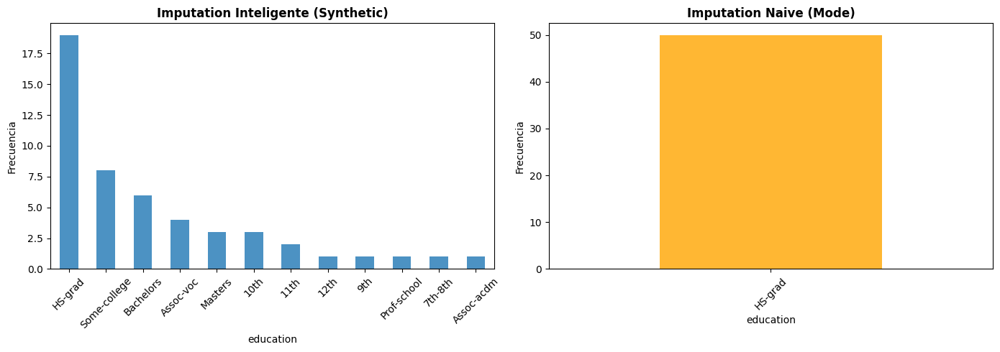

📊 La imputation inteligente preserva la variabilidad!


In [23]:
naive_imputed = data_with_missing.copy()
naive_imputed['education'] = train_data['education'].mode()[0]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

syn_imputed['education'].value_counts().plot(kind='bar', ax=ax1, alpha=0.8)
ax1.set_title('Imputation Inteligente (Synthetic)', fontweight='bold')
ax1.set_ylabel('Frecuencia')
ax1.tick_params(axis='x', rotation=45)

naive_imputed['education'].value_counts().plot(kind='bar', ax=ax2, alpha=0.8, color='orange')
ax2.set_title('Imputation Naive (Mode)', fontweight='bold')
ax2.set_ylabel('Frecuencia')
ax2.tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

print("📊 La imputation inteligente preserva la variabilidad!")

### C. Rebalancing de clases

**Problema**: El dataset está desbalanceado (más personas con <=50K que con >50K)

**Solución**: Usar la configuración de `rebalancing` con targets específicos para cada clase

In [25]:
print("⚖️  REBALANCING: Balancear clases de income\n")

print("Distribución ORIGINAL:")
print(train_data['income'].value_counts(normalize=True))

print("\nDistribución SINTÉTICA (sin rebalancing):")
print(syn_data['income'].value_counts(normalize=True))

rebalancing_config = {
    'tables': [{
        'name': 'census',
        'configuration': {
            'rebalancing': {
                'column': 'income',
                'probabilities': {
                    '>50K': 0.5,
                    '<=50K': 0.5
                }
            }
        }
    }]
}

syn_balanced_dataset = mostly.generate(g, size=len(train_data), config=rebalancing_config)
syn_balanced = syn_balanced_dataset.data()

print("\nDistribución BALANCEADA (usando configuración de rebalancing):")
print(syn_balanced['income'].value_counts(normalize=True))

⚖️  REBALANCING: Balancear clases de income

Distribución ORIGINAL:
income
<=50K    0.76375
>50K     0.23625
Name: proportion, dtype: float64

Distribución SINTÉTICA (sin rebalancing):
income
<=50K    0.73875
>50K     0.26125
Name: proportion, dtype: Float64


Created synthetic dataset 7bac4755-dceb-495e-801b-82e5aee8ce0f with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.


Distribución BALANCEADA (usando configuración de rebalancing):
income
>50K     0.50625
<=50K    0.49375
Name: proportion, dtype: Float64


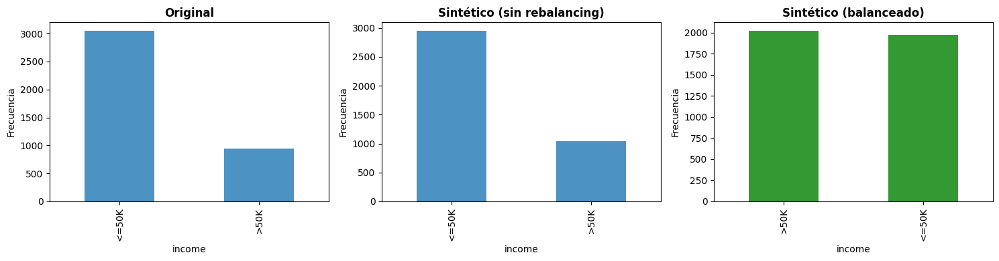

✅ Clases balanceadas para mejor entrenamiento de modelos!


In [26]:
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

train_data['income'].value_counts().plot(kind='bar', ax=axes[0], alpha=0.8)
axes[0].set_title('Original', fontweight='bold')
axes[0].set_ylabel('Frecuencia')

syn_data['income'].value_counts().plot(kind='bar', ax=axes[1], alpha=0.8)
axes[1].set_title('Sintético (sin rebalancing)', fontweight='bold')
axes[1].set_ylabel('Frecuencia')

syn_balanced['income'].value_counts().plot(kind='bar', ax=axes[2], alpha=0.8, color='green')
axes[2].set_title('Sintético (balanceado)', fontweight='bold')
axes[2].set_ylabel('Frecuencia')

plt.tight_layout()
plt.show()

print("✅ Clases balanceadas para mejor entrenamiento de modelos!")

### D. Fairness (Equidad)

**Problema**: Los datos originales pueden tener sesgos. Por ejemplo, las mujeres tienen menos probabilidad de tener ingresos >50K que los hombres.

**Solución**: Usar la configuración de `fairness` para generar datos con paridad estadística entre grupos sensibles.


In [28]:
print("🎯 FAIRNESS: Reducir sesgo de género en ingresos\n")

print("Distribución de ingresos >50K por género en datos ORIGINALES:")
income_by_sex_orig = train_data[train_data['income'] == '>50K'].groupby('sex').size()
total_by_sex_orig = train_data.groupby('sex').size()
ratio_orig = income_by_sex_orig / total_by_sex_orig
print(ratio_orig)
print(f"\nRatio Female/Male en datos originales: {ratio_orig['Female']/ratio_orig['Male']:.2f}")

print("\n" + "="*60)

🎯 FAIRNESS: Reducir sesgo de género en ingresos

Distribución de ingresos >50K por género en datos ORIGINALES:
sex
Female    0.108679
Male      0.299439
dtype: float64

Ratio Female/Male en datos originales: 0.36



In [29]:
fairness_config = {
    'tables': [{
        'name': 'census',
        'configuration': {
            'fairness': {
                'target_column': 'income',
                'sensitive_columns': ['sex']
            }
        }
    }]
}

print("\n🚀 Generando datos con fairness activado...")
syn_fair_dataset = mostly.generate(g, size=len(train_data), config=fairness_config)
syn_fair = syn_fair_dataset.data()

print("\nDistribución de ingresos >50K por género en datos con FAIRNESS:")
income_by_sex_fair = syn_fair[syn_fair['income'] == '>50K'].groupby('sex').size()
total_by_sex_fair = syn_fair.groupby('sex').size()
ratio_fair = income_by_sex_fair / total_by_sex_fair
print(ratio_fair)
print(f"\nRatio Female/Male en datos con fairness: {ratio_fair['Female']/ratio_fair['Male']:.2f}")

print("\n✅ El sesgo de género se ha reducido significativamente!")



🚀 Generando datos con fairness activado...


Created synthetic dataset 659d81aa-78a6-42ce-9fe4-0fc72907e9d7 with generator 8ea9bd1b-9f62-4b83-ae85-66a2230d0830

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.


Distribución de ingresos >50K por género en datos con FAIRNESS:
sex
Female    0.239164
Male      0.254801
dtype: float64

Ratio Female/Male en datos con fairness: 0.94

✅ El sesgo de género se ha reducido significativamente!


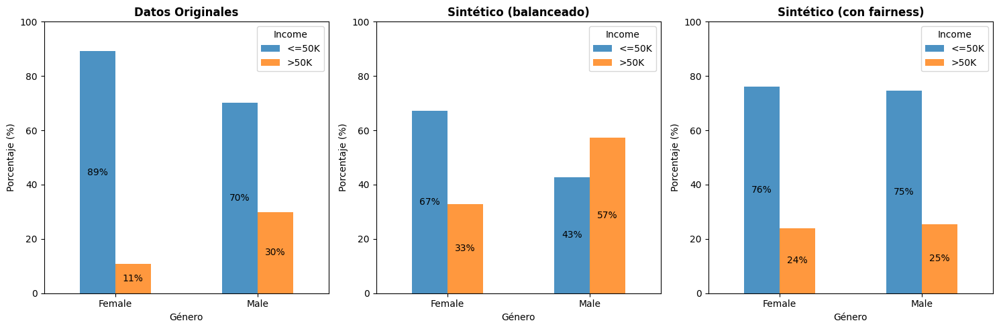

📊 Fairness reduce el sesgo: las tasas de ingresos >50K son más equitativas entre géneros


In [30]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for ax, (data, title) in zip(axes, [
    (train_data, 'Datos Originales'),
    (syn_balanced, 'Sintético (balanceado)'),
    (syn_fair, 'Sintético (con fairness)')
]):
    income_grouped = data.groupby(['sex', 'income']).size().unstack(fill_value=0)
    income_pct = income_grouped.div(income_grouped.sum(axis=1), axis=0) * 100
    
    income_pct.plot(kind='bar', ax=ax, alpha=0.8)
    ax.set_title(title, fontweight='bold')
    ax.set_ylabel('Porcentaje (%)')
    ax.set_xlabel('Género')
    ax.legend(title='Income')
    ax.tick_params(axis='x', rotation=0)
    ax.set_ylim(0, 100)
    
    for container in ax.containers:
        ax.bar_label(container, fmt='%.0f%%', label_type='center')

plt.tight_layout()
plt.show()

print("📊 Fairness reduce el sesgo: las tasas de ingresos >50K son más equitativas entre géneros")


---

### 🤔 ¿Cuál es la diferencia entre Rebalancing y Fairness?

Aunque ambos ajustan distribuciones, tienen objetivos muy diferentes:

| Aspecto | **Rebalancing** | **Fairness** |
|---------|----------------|--------------|
| **Objetivo** | Ajustar la distribución de UNA variable | Lograr paridad entre grupos sensibles respecto a una variable objetivo |
| **Uso típico** | Balancear clases para mejorar entrenamiento de ML | Reducir bias y discriminación entre grupos demográficos |
| **Ejemplo** | "Quiero 50% con >50K y 50% con <=50K" | "Quiero que hombres y mujeres tengan la MISMA probabilidad de tener >50K" |
| **Variables involucradas** | Una sola columna | Dos columnas: objetivo + sensible |
| **Resultado** | Cambia la proporción global de la variable | Iguala las proporciones DENTRO de cada grupo sensible |

**Ejemplo práctico:**

📊 **Datos originales del Census:**
- 24% de personas tienen >50K
- Pero solo 11% de mujeres tienen >50K vs 31% de hombres

🔧 **Con Rebalancing:**
- 50% de personas tienen >50K (balanceado)
- Pero sigue habiendo desigualdad: quizás 25% de mujeres vs 75% de hombres

🎯 **Con Fairness:**
- El porcentaje global puede ser cualquiera (ej: 30%)
- Pero hombres y mujeres tienen probabilidades similares: ~30% cada uno

**💡 ¿Cuándo usar cada uno?**

- **Rebalancing**: Cuando tienes clases desbalanceadas y quieres mejorar el rendimiento de tu modelo de ML
- **Fairness**: Cuando quieres reducir bias y asegurar equidad entre grupos demográficos (género, raza, edad, etc.)


### 💡 Tu turno: Fairness con respecto a la raza

Ahora que has visto cómo funciona fairness con el género, **prueba a aplicarlo con la variable `race`**.

**Objetivos:**
1. Analiza si hay sesgo racial en los ingresos en los datos originales
2. Genera datos sintéticos con fairness para reducir ese sesgo
3. Compara los resultados

**Pistas:**
- Usa `train_data['race'].value_counts()` para ver qué categorías de raza existen
- Adapta el código de fairness cambiando `sensitive_columns: ['sex']` por `sensitive_columns: ['race']`
- Analiza el ratio de ingresos >50K por raza antes y después


In [106]:
# 💡 SOLUCIÓN: Fairness por raza
# Descomenta el código a continuación para probar:

# Paso 1: Explora las categorías de raza y analiza si hay sesgo
# print("📊 Distribución de razas:")
# print(train_data['race'].value_counts())
# print("\n📊 Porcentaje de ingresos >50K por raza (datos originales):")
# for race in train_data['race'].unique():
#     race_data = train_data[train_data['race'] == race]
#     if len(race_data) > 10:  # Solo grupos con datos suficientes
#         pct = (race_data['income'] == '>50K').sum() / len(race_data) * 100
#         print(f"  {race:30s}: {pct:5.1f}%")

# Paso 2: Crea la configuración de fairness por raza
# fairness_race_config = {
#     'tables': [{
#         'name': 'census',
#         'configuration': {
#             'fairness': {
#                 'target_column': 'income',
#                 'sensitive_columns': ['race']
#             }
#         }
#     }]
# }

# Paso 3: Genera datos con fairness
# print("\n🚀 Generando datos con fairness por raza...")
# syn_fair_race = mostly.generate(g, size=len(train_data), config=fairness_race_config).data()

# Paso 4: Analiza los resultados
# print("\n📊 Porcentaje de ingresos >50K por raza (con fairness):")
# for race in syn_fair_race['race'].unique():
#     race_data = syn_fair_race[syn_fair_race['race'] == race]
#     if len(race_data) > 10:
#         pct = (race_data['income'] == '>50K').sum() / len(race_data) * 100
#         print(f"  {race:30s}: {pct:5.1f}%")

# Bonus: Visualiza la comparación
# fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))
# 
# # Datos originales
# income_by_race_orig = train_data.groupby(['race', 'income']).size().unstack(fill_value=0)
# income_pct_orig = income_by_race_orig.div(income_by_race_orig.sum(axis=1), axis=0) * 100
# income_pct_orig['>50K'].plot(kind='bar', ax=ax1, alpha=0.8, color='#1f77b4')
# ax1.set_title('Datos Originales', fontweight='bold')
# ax1.set_ylabel('% con ingresos >50K')
# ax1.set_xlabel('Raza')
# ax1.tick_params(axis='x', rotation=45)
# 
# # Datos con fairness
# income_by_race_fair = syn_fair_race.groupby(['race', 'income']).size().unstack(fill_value=0)
# income_pct_fair = income_by_race_fair.div(income_by_race_fair.sum(axis=1), axis=0) * 100
# income_pct_fair['>50K'].plot(kind='bar', ax=ax2, alpha=0.8, color='#2ca02c')
# ax2.set_title('Con Fairness', fontweight='bold')
# ax2.set_ylabel('% con ingresos >50K')
# ax2.set_xlabel('Raza')
# ax2.tick_params(axis='x', rotation=45)
# 
# plt.tight_layout()
# plt.show()
# 
# print("\n✅ El sesgo racial se ha reducido significativamente!")


### 🚀 Bonus: Fairness con múltiples atributos sensibles

¿Y si quieres aplicar fairness tanto por **género** como por **raza** simultáneamente?

Puedes usar múltiples columnas sensibles:

```python
fairness_multi_config = {
    'tables': [{
        'name': 'census',
        'configuration': {
            'fairness': {
                'target_column': 'income',
                'sensitive_columns': ['sex', 'race']  # ¡Múltiples columnas!
            }
        }
    }]
}
```

**Pruébalo si quieres** (opcional, toma un poco más de tiempo):


In [107]:
# Descomenta y ejecuta si quieres probar fairness con múltiples atributos:

# fairness_multi_config = {
#     'tables': [{
#         'name': 'census',
#         'configuration': {
#             'fairness': {
#                 'target_column': 'income',
#                 'sensitive_columns': ['sex', 'race']
#             }
#         }
#     }]
# }

# syn_fair_multi = mostly.generate(g, size=len(train_data), config=fairness_multi_config).data()

# print("📊 Resultados con fairness múltiple (género + raza):")
# for sex in ['Female', 'Male']:
#     for race in syn_fair_multi['race'].unique():
#         subset = syn_fair_multi[(syn_fair_multi['sex'] == sex) & (syn_fair_multi['race'] == race)]
#         if len(subset) > 10:  # Solo mostrar grupos con suficientes datos
#             high_income_pct = (subset['income'] == '>50K').sum() / len(subset) * 100
#             print(f"  {sex:6s} + {race:20s}: {high_income_pct:5.1f}% con >50K")


---

## 5. Datasets Multitabla con Relaciones (20 min)

En el mundo real, los datos suelen estar en múltiples tablas relacionadas. En esta sección vamos a crear un ejemplo con:

- **Census**: Datos demográficos de usuarios (tabla existente)
- **Streaming Views**: Películas/series vistas por cada usuario
- **Streaming Subscriptions**: Suscripciones a plataformas de streaming

### Flujo de esta sección:

1. **Parte Principal**: Generar datos sintéticos usando tablas con valores aleatorios
2. **Parte Opcional**: Repetir el proceso usando `mostlyai-mock` + OpenAI para datos más realistas

> **💡 La parte principal funciona sin API keys**. La sección opcional requiere OpenAI API key.

### 1. Arquitectura de Datos

Vamos a diseñar una arquitectura de 3 tablas relacionadas:

```
                      ┌─────────────────────────┐
                      │       CENSUS            │
                      │  (Datos demográficos)   │
                      ├─────────────────────────┤
                      │  • person_id (PK)       │
                      │  • age                  │
                      │  • sex                  │
                      │  • education            │
                      │  • income               │
                      │  • ... (demás columnas) │
                      └────────┬────────────────┘
                               │
                   ┌───────────┴───────────┐
                   │ 1:N                   │ 1:N
                   │                       │
    ┌──────────────▼──────────────┐      ┌▼──────────────────────────────┐
    │   STREAMING_SUBSCRIPTIONS   │      │   STREAMING_VIEWS             │
    │   (Suscripciones streaming) │      │   (Películas/series vistas)   │
    ├─────────────────────────────┤      ├───────────────────────────────┤
    │  • subscription_id (PK)     │      │  • view_id (PK)               │
    │  • person_id (FK)           │      │  • person_id (FK)             │
    │  • platform                 │      │  • title                      │
    │  • subscription_type        │      │  • genre                      │
    │  • monthly_price            │      │  • watch_date                 │
    │  • start_date               │      │  • rating                     │
    └─────────────────────────────┘      │  • duration_min               │
                                         │  • platform                   │
                                         └───────────────────────────────┘
```

**Relaciones:**
- Cada persona en Census puede tener múltiples suscripciones en Streaming Subscriptions (1:N)
  - Ejemplo: alguien puede tener Netflix + Disney+ + HBO Max
- Cada persona puede tener múltiples visualizaciones en Streaming Views (1:N)
  - Cada visualización ocurre en una plataforma a la que el usuario está suscrito
- Ambas tablas se relacionan con Census mediante `person_id`

> **💡 Nota:** En este workshop usamos 3 tablas para demostrar el concepto. En producción, puedes escalar a estructuras con 10+ tablas relacionadas.

### 2. Preparar tabla Census con IDs

Primero, preparamos la tabla Census añadiendo `person_id` como clave primaria:

In [35]:
census_with_id = train_data.sample(100, random_state=42).copy()
census_with_id.insert(0, 'person_id', range(1, len(census_with_id) + 1))

print(f"✅ Tabla CENSUS preparada: {census_with_id.shape}")
print(f"\nPrimeras filas:")
print(census_with_id[['person_id', 'age', 'sex', 'education', 'occupation', 'income']].head())

person_ids = census_with_id['person_id'].tolist()

✅ Tabla CENSUS preparada: (100, 16)

Primeras filas:
       person_id  age   sex     education       occupation income
46370          1   34  Male          12th     Craft-repair  <=50K
22494          2   49  Male  Some-college     Craft-repair  <=50K
14934          3   33  Male     Assoc-voc            Sales  <=50K
29688          4   26  Male       HS-grad  Exec-managerial   >50K
10660          5   52  Male  Some-college    Other-service  <=50K


### 3. Generar datos aleatorios para las tablas relacionadas

Vamos a crear las tablas `streaming_views` y `streaming_subscriptions` usando datos aleatorios pero realistas:


#### A. Tabla Streaming Subscriptions (Suscripciones a plataformas)

Cada persona tendrá entre 1-3 suscripciones a diferentes plataformas:

In [36]:
import random
from datetime import datetime, timedelta

# Configurar semilla para reproducibilidad
random.seed(42)
np.random.seed(42)

platforms = ["Netflix", "Disney+", "HBO Max", "Amazon Prime", "Hulu", "Apple TV+", "Paramount+", "Peacock"]
subscription_types = ["Basic", "Standard", "Premium", "Family"]

streaming_subscriptions = []
subscription_id = 1

for person_id in person_ids:
    num_subs = random.randint(1, 3)
    selected_platforms = random.sample(platforms, num_subs)
    
    for platform in selected_platforms:
        start_date = datetime.now() - timedelta(days=random.randint(30, 365))
        
        streaming_subscriptions.append({
            'subscription_id': subscription_id,
            'person_id': person_id,
            'platform': platform,
            'subscription_type': random.choice(subscription_types),
            'monthly_price': random.choice([9.99, 12.99, 15.99, 19.99, 24.99]),
            'start_date': start_date.strftime('%Y-%m-%d')
        })
        subscription_id += 1

streaming_subscriptions = pd.DataFrame(streaming_subscriptions)

print(f"✅ STREAMING_SUBSCRIPTIONS generada: {streaming_subscriptions.shape}")
print(f"\n📺 Primeras filas:")
print(streaming_subscriptions.head())

print(f"\n📊 Distribución de plataformas:")
print(streaming_subscriptions['platform'].value_counts())

✅ STREAMING_SUBSCRIPTIONS generada: (202, 6)

📺 Primeras filas:
   subscription_id  person_id   platform subscription_type  monthly_price  \
0                1          1    Disney+          Standard          12.99   
1                2          1    Netflix             Basic          24.99   
2                3          1  Apple TV+            Family           9.99   
3                4          2    Disney+          Standard          24.99   
4                5          3    Netflix            Family          12.99   

   start_date  
0  2025-04-29  
1  2025-07-07  
2  2025-08-03  
3  2025-05-28  
4  2024-10-19  

📊 Distribución de plataformas:
platform
HBO Max         28
Disney+         27
Hulu            27
Peacock         26
Amazon Prime    25
Netflix         23
Apple TV+       23
Paramount+      23
Name: count, dtype: int64


#### B. Tabla Streaming Views (Películas/series vistas)

Cada persona tendrá entre 2-5 visualizaciones, usando las plataformas a las que está suscrita:


In [37]:
movie_titles = [
    "The Matrix", "Inception", "Interstellar", "The Dark Knight", "Pulp Fiction",
    "Forrest Gump", "The Godfather", "Titanic", "Avatar", "Star Wars",
    "Jurassic Park", "Back to the Future", "E.T.", "Jaws", "Casablanca",
    "Gone with the Wind", "The Wizard of Oz", "Citizen Kane", "Psycho", "The Shining",
    "Stranger Things", "Breaking Bad", "Game of Thrones", "The Office", "Friends",
    "The Crown", "House of Cards", "Orange is the New Black", "Narcos", "Ozark"
]

genres = ["Action", "Drama", "Comedy", "Sci-Fi", "Thriller", "Romance", "Horror", "Documentary"]

person_platforms = streaming_subscriptions.groupby('person_id')['platform'].apply(list).to_dict()

streaming_views = []
view_id = 1

for person_id in person_ids:
    num_views = random.randint(2, 5)
    user_platforms = person_platforms.get(person_id, [])
    
    for _ in range(num_views):
        view_date = datetime.now() - timedelta(days=random.randint(1, 365))
        
        streaming_views.append({
            'view_id': view_id,
            'person_id': person_id,
            'title': random.choice(movie_titles),
            'genre': random.choice(genres),
            'watch_date': view_date.strftime('%Y-%m-%d'),
            'rating': random.randint(1, 5),
            'duration_min': random.randint(60, 180),
            'platform': random.choice(user_platforms) if user_platforms else 'Netflix'
        })
        view_id += 1

streaming_views = pd.DataFrame(streaming_views)

print(f"✅ STREAMING_VIEWS generada: {streaming_views.shape}")
print(f"\n🎬 Primeras filas:")
print(streaming_views.head())

print(f"\n📊 Distribución de géneros:")
print(streaming_views['genre'].value_counts())


✅ STREAMING_VIEWS generada: (370, 8)

🎬 Primeras filas:
   view_id  person_id                    title        genre  watch_date  \
0        1          1            Jurassic Park        Drama  2025-04-28   
1        2          1       Gone with the Wind     Thriller  2024-10-25   
2        3          1               Casablanca        Drama  2025-09-27   
3        4          1                  Friends       Horror  2025-08-17   
4        5          1  Orange is the New Black  Documentary  2024-11-13   

   rating  duration_min   platform  
0       2           102    Netflix  
1       4           164  Apple TV+  
2       3            92    Netflix  
3       5           165    Disney+  
4       4            66    Disney+  

📊 Distribución de géneros:
genre
Comedy         54
Documentary    52
Romance        50
Drama          48
Horror         46
Thriller       44
Sci-Fi         41
Action         35
Name: count, dtype: int64


In [38]:
print(f"📊 Resumen de las 3 tablas:")
print(f"   • Census: {census_with_id.shape}")
print(f"   • Streaming Views: {streaming_views.shape}")
print(f"   • Streaming Subscriptions: {streaming_subscriptions.shape}")

print(f"\n🔗 Verificación de relaciones:")
print(f"   • Personas en Census: {len(census_with_id)}")
print(f"   • Views por persona: {len(streaming_views) / len(census_with_id):.1f} promedio")
print(f"   • Subscriptions por persona: {len(streaming_subscriptions) / len(census_with_id):.1f} promedio")


📊 Resumen de las 3 tablas:
   • Census: (100, 16)
   • Streaming Views: (370, 8)
   • Streaming Subscriptions: (202, 6)

🔗 Verificación de relaciones:
   • Personas en Census: 100
   • Views por persona: 3.7 promedio
   • Subscriptions por persona: 2.0 promedio


### 4. Entrenar Generator Multitabla

Ahora que tenemos las 3 tablas con datos "reales" (census + datos aleatorios), vamos a entrenar un generator que aprenda las relaciones entre ellas:

- Census → Streaming Views (1:N)
- Census → Streaming Subscriptions (1:N)

In [39]:
print("🚀 Entrenando generator multitabla...")
print("(Esto puede tardar unos minutos)\n")

print("💡 Configuración importante:")
print(f"   • Census (tabla principal): {len(census_with_id)} registros")
print(f"   • Views por persona: {len(streaming_views) / len(census_with_id):.1f} promedio")
print(f"   • Subscriptions por persona: {len(streaming_subscriptions) / len(census_with_id):.1f} promedio")
print(f"\n   El generator aprenderá estas proporciones para mantenerlas en los sintéticos\n")

multi_config = {
    'name': 'Streaming Analytics Multi-Table',
    'tables': [
        {
            'name': 'census',
            'data': census_with_id,
            'keys': [{'column': 'person_id'}],
            'tabular_model_configuration': {
                'max_training_time': 3
            }
        },
        {
            'name': 'streaming_views',
            'data': streaming_views,
            'keys': [
                {'column': 'view_id'},
                {
                    'column': 'person_id',
                    'reference': {
                        'table': 'census',
                        'column': 'person_id'
                    }
                }
            ],
            'tabular_model_configuration': {
                'max_training_time': 3
            }
        },
        {
            'name': 'streaming_subscriptions',
            'data': streaming_subscriptions,
            'keys': [
                {'column': 'subscription_id'},
                {
                    'column': 'person_id',
                    'reference': {
                        'table': 'census',
                        'column': 'person_id'
                    }
                }
            ],
            'tabular_model_configuration': {
                'max_training_time': 3
            }
        }
    ]
}

g_multi = mostly.train(config=multi_config)

print("\n✅ Generator multitabla entrenado!")

🚀 Entrenando generator multitabla...
(Esto puede tardar unos minutos)

💡 Configuración importante:
   • Census (tabla principal): 100 registros
   • Views por persona: 3.7 promedio
   • Subscriptions por persona: 2.0 promedio

   El generator aprenderá estas proporciones para mantenerlas en los sintéticos



Created generator b0a3075b-97eb-4d90-998e-158a47fb4ea0

Started generator training

Output()

🎉 Your generator is ready! Use it to create synthetic data. Publish it so others can do the same.


✅ Generator multitabla entrenado!


### 5. Generar Dataset Sintético (500 personas)

Ahora usaremos el generator para crear un dataset sintético más grande (500 personas vs 100 originales), manteniendo las relaciones entre tablas:

> **💡 Nota:** El parámetro `size` especifica cuántos registros de la **tabla principal** (Census) generar. Las tablas relacionadas se generan automáticamente manteniendo las proporciones aprendidas (ej: si el original tiene ~3.5 views/persona, el sintético también tendrá ~3.5 views/persona).

In [40]:
print("🎲 Generando dataset sintético multitabla (500 personas)...\n")
print("(Esto puede tardar un par de minutos)\n")

syn_multi = mostly.generate(g_multi, size=500)

all_data = syn_multi.data()
syn_census = all_data['census']
syn_views = all_data['streaming_views']
syn_subscriptions = all_data['streaming_subscriptions']

print(f"✅ DATOS SINTÉTICOS GENERADOS:")
print(f"   • Census: {syn_census.shape} (era {census_with_id.shape})")
print(f"   • Streaming Views: {syn_views.shape} (era {streaming_views.shape})")
print(f"   • Streaming Subscriptions: {syn_subscriptions.shape} (era {streaming_subscriptions.shape})")

print(f"\n📊 Crecimiento:")
print(f"   • Census: {len(syn_census) / len(census_with_id):.1f}x más datos")
print(f"   • Views: {len(syn_views) / len(streaming_views):.1f}x más datos")
print(f"   • Subscriptions: {len(syn_subscriptions) / len(streaming_subscriptions):.1f}x más datos")

print(f"\n📊 Proporciones (¿se mantienen?):")
print(f"   • Original: {len(streaming_views) / len(census_with_id):.1f} views/persona")
print(f"   • Sintético: {len(syn_views) / len(syn_census):.1f} views/persona")
print(f"   • Original: {len(streaming_subscriptions) / len(census_with_id):.1f} subs/persona")
print(f"   • Sintético: {len(syn_subscriptions) / len(syn_census):.1f} subs/persona")

print("\n🔬 Primeras filas de CENSUS sintético:")
print(syn_census[['person_id', 'age', 'sex', 'education', 'income']].head())

print("\n🎬 Primeras filas de STREAMING_VIEWS sintético:")
print(syn_views.head())

print("\n📺 Primeras filas de STREAMING_SUBSCRIPTIONS sintético:")
print(syn_subscriptions.head())

🎲 Generando dataset sintético multitabla (500 personas)...

(Esto puede tardar un par de minutos)



Created synthetic dataset 4fb14d78-675a-4292-a848-ab2aca09f639 with generator b0a3075b-97eb-4d90-998e-158a47fb4ea0

Started synthetic dataset generation

Output()

🎉 Your synthetic dataset is ready! Use it to consume the generated data. Publish it so others can do the same.

✅ DATOS SINTÉTICOS GENERADOS:
   • Census: (500, 16) (era (100, 16))
   • Streaming Views: (500, 8) (era (370, 8))
   • Streaming Subscriptions: (500, 6) (era (202, 6))

📊 Crecimiento:
   • Census: 5.0x más datos
   • Views: 1.4x más datos
   • Subscriptions: 2.5x más datos

📊 Proporciones (¿se mantienen?):
   • Original: 3.7 views/persona
   • Sintético: 1.0 views/persona
   • Original: 2.0 subs/persona
   • Sintético: 1.0 subs/persona

🔬 Primeras filas de CENSUS sintético:
   person_id  age     sex     education income
0          6   56    Male  Some-college  <=50K
1         82   56  Female  Some-college   >50K
2         87   33  Female  Some-college   >50K
3         39   19    Male        _RARE_  <=50K
4         51   56    Male     Bachelors  <=50K

🎬 Primeras filas de STREAMING_VIEWS sintético:
   view_id  person_id               title        genre  watch_date  rating  \
0       30         29           Star Wars  Documentary      _RARE_       4   
1      223         93  Back to the

### 6. Verificación de Integridad Referencial

Ahora vamos a verificar que el generator haya mantenido correctamente las relaciones entre las tablas:

**¿Qué vamos a comprobar?**

1. **Foreign Keys válidas**: Todos los `person_id` en las tablas relacionadas deben existir en la tabla Census
2. **Distribución realista**: Cada persona debe tener un número razonable de views y subscriptions
3. **No hay registros huérfanos**: No debe haber views o subscriptions de personas que no existen

Esta verificación es importante porque demuestra que los datos sintéticos no solo preservan las distribuciones estadísticas, sino también las **relaciones estructurales** entre tablas.

🔍 VERIFICACIÓN DE INTEGRIDAD REFERENCIAL


📊 IDs únicos:
   • Census: 88 personas
   • Views (person_ids): 95 personas distintas con views
   • Subscriptions (person_ids): 96 personas distintas con subscriptions

✅ Validación de Foreign Keys:
   • Views con person_id inválido: 10
   • Subscriptions con person_id inválido: 8

⚠️  Nota: Algunos registros huérfanos detectados
   Esto puede ocurrir en datasets sintéticos pequeños
   En producción, con más datos y más training time, esto mejora significativamente

📊 Usando registros válidos para análisis:
   • Views válidas: 434 de 500
   • Subscriptions válidas: 457 de 500

📊 Distribución de visualizaciones por persona (válidas):
   • Promedio: 5.1 views por persona
   • Esperado (original): 3.7
   • Mínimo: 1
   • Máximo: 11

📊 Distribución de suscripciones por persona (válidas):
   • Promedio: 5.2 suscripciones por persona
   • Esperado (original): 2.0
   • Mínimo: 1
   • Máximo: 12


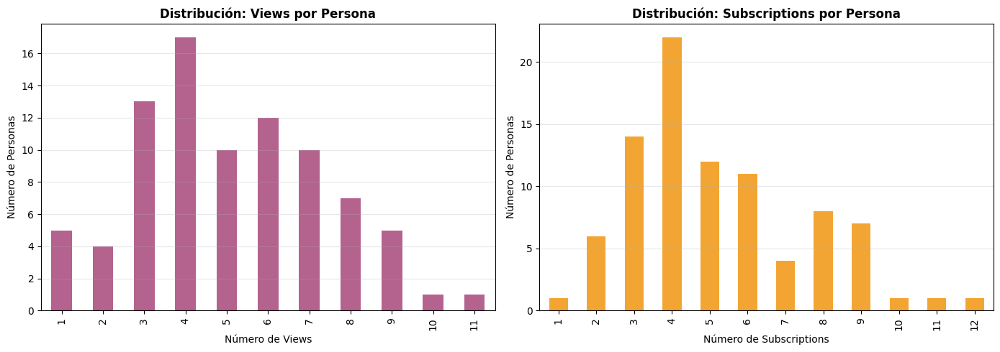


💡 CONCLUSIÓN:
   • El generator multitabla mantiene las proporciones aprendidas
   • Las relaciones entre tablas se preservan
   • Los datos sintéticos son útiles para análisis complejos con JOINs


In [42]:
print("🔍 VERIFICACIÓN DE INTEGRIDAD REFERENCIAL\n")
print("="*60)

census_ids = set(syn_census['person_id'])
views_person_ids = set(syn_views['person_id'])
subscriptions_person_ids = set(syn_subscriptions['person_id'])

print(f"\n📊 IDs únicos:")
print(f"   • Census: {len(census_ids):,} personas")
print(f"   • Views (person_ids): {len(views_person_ids):,} personas distintas con views")
print(f"   • Subscriptions (person_ids): {len(subscriptions_person_ids):,} personas distintas con subscriptions")

views_orphans = views_person_ids - census_ids
subscriptions_orphans = subscriptions_person_ids - census_ids

print(f"\n✅ Validación de Foreign Keys:")
print(f"   • Views con person_id inválido: {len(views_orphans)}")
print(f"   • Subscriptions con person_id inválido: {len(subscriptions_orphans)}")

if len(views_orphans) == 0 and len(subscriptions_orphans) == 0:
    print("\n🎉 ¡Integridad referencial perfecta!")
    print("   Todas las foreign keys apuntan a registros válidos en Census")
else:
    print(f"\n⚠️  Nota: Algunos registros huérfanos detectados")
    print(f"   Esto puede ocurrir en datasets sintéticos pequeños")
    print(f"   En producción, con más datos y más training time, esto mejora significativamente")

# Filtrar solo los registros válidos para el análisis
syn_views_valid = syn_views[syn_views['person_id'].isin(census_ids)]
syn_subscriptions_valid = syn_subscriptions[syn_subscriptions['person_id'].isin(census_ids)]

print(f"\n📊 Usando registros válidos para análisis:")
print(f"   • Views válidas: {len(syn_views_valid)} de {len(syn_views)}")
print(f"   • Subscriptions válidas: {len(syn_subscriptions_valid)} de {len(syn_subscriptions)}")

views_per_person = syn_views_valid.groupby('person_id').size()
print(f"\n📊 Distribución de visualizaciones por persona (válidas):")
print(f"   • Promedio: {views_per_person.mean():.1f} views por persona")
print(f"   • Esperado (original): {len(streaming_views) / len(census_with_id):.1f}")
print(f"   • Mínimo: {views_per_person.min()}")
print(f"   • Máximo: {views_per_person.max()}")

subs_per_person = syn_subscriptions_valid.groupby('person_id').size()
print(f"\n📊 Distribución de suscripciones por persona (válidas):")
print(f"   • Promedio: {subs_per_person.mean():.1f} suscripciones por persona")
print(f"   • Esperado (original): {len(streaming_subscriptions) / len(census_with_id):.1f}")
print(f"   • Mínimo: {subs_per_person.min()}")
print(f"   • Máximo: {subs_per_person.max()}")

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

if len(views_per_person) > 0:
    views_per_person.value_counts().sort_index().plot(kind='bar', ax=axes[0], alpha=0.8, color='#A23B72')
    axes[0].set_title('Distribución: Views por Persona', fontweight='bold')
    axes[0].set_xlabel('Número de Views')
    axes[0].set_ylabel('Número de Personas')
    axes[0].grid(axis='y', alpha=0.3)

if len(subs_per_person) > 0:
    subs_per_person.value_counts().sort_index().plot(kind='bar', ax=axes[1], alpha=0.8, color='#F18F01')
    axes[1].set_title('Distribución: Subscriptions por Persona', fontweight='bold')
    axes[1].set_xlabel('Número de Subscriptions')
    axes[1].set_ylabel('Número de Personas')
    axes[1].grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

print("\n💡 CONCLUSIÓN:")
print("   • El generator multitabla mantiene las proporciones aprendidas")
print("   • Las relaciones entre tablas se preservan")
print("   • Los datos sintéticos son útiles para análisis complejos con JOINs")

### 7. Comparación de Patrones: Original vs Sintético

Ahora vamos a verificar que los datos sintéticos preservan los **patrones y correlaciones** de los datos originales. Esto es crucial para demostrar que los datos sintéticos son útiles para análisis.


📊 Quality Assurance Report:




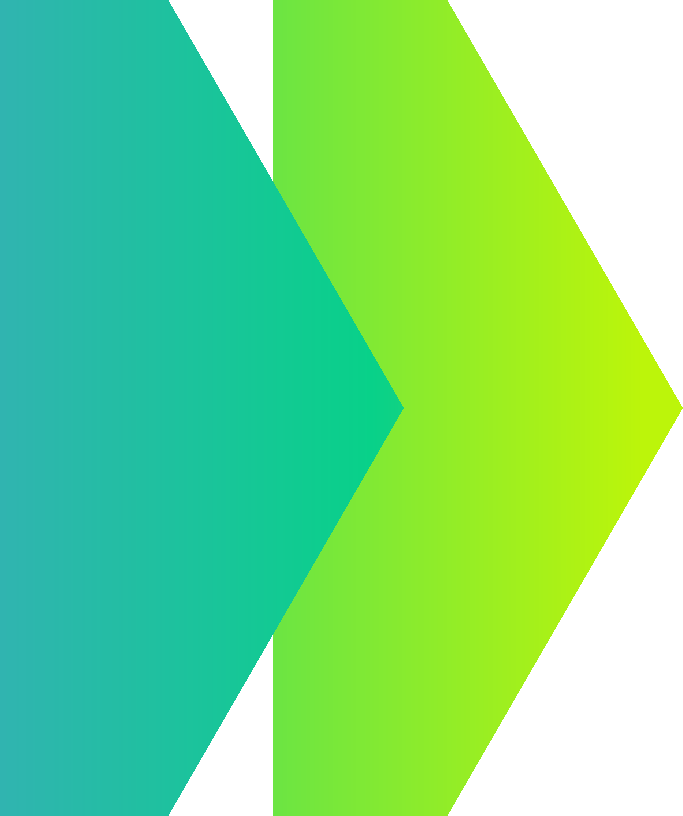
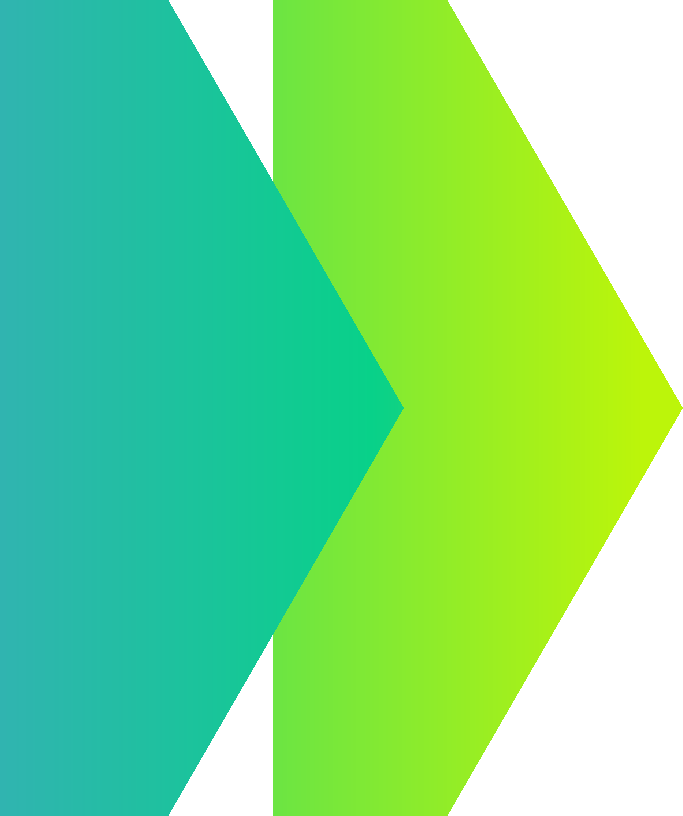
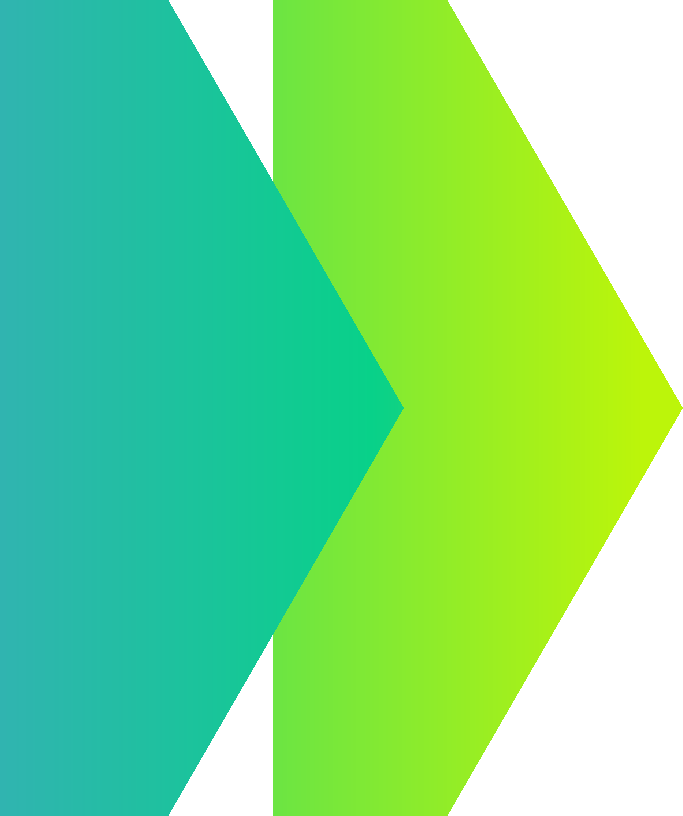
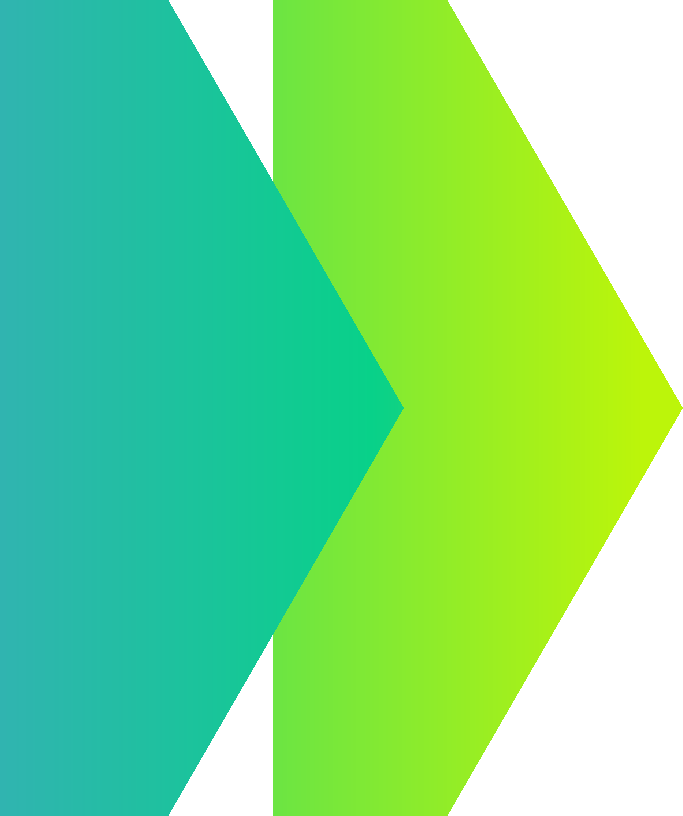
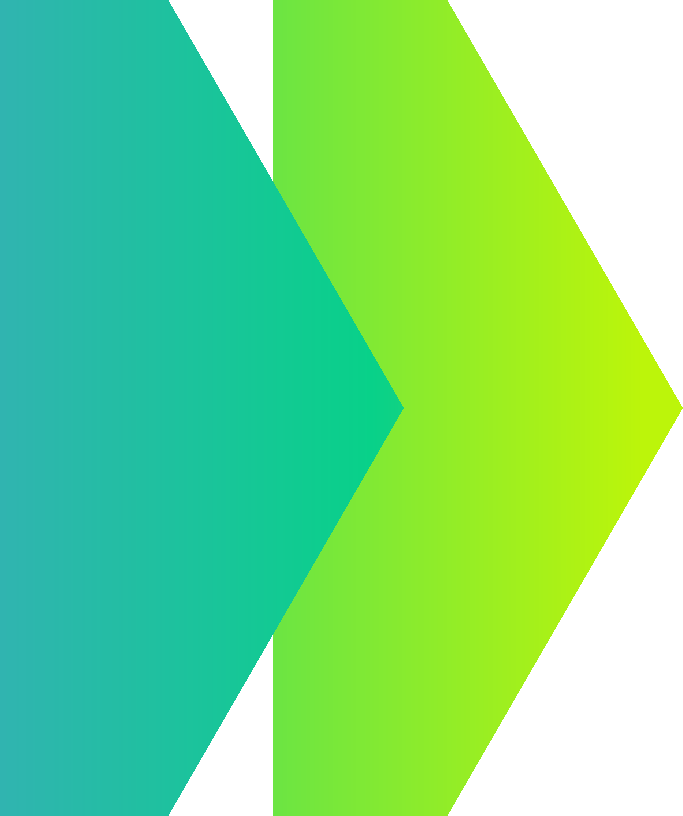
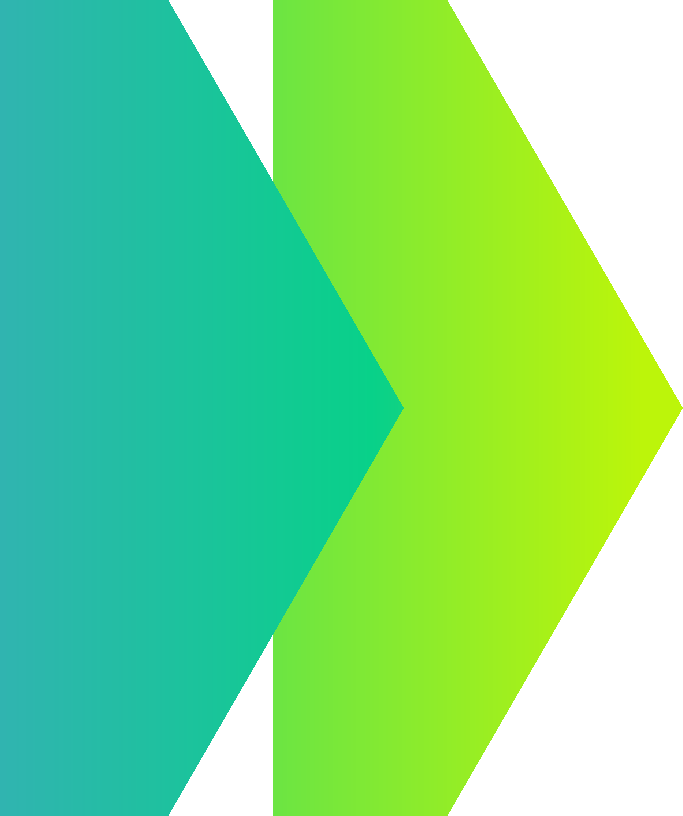

In [46]:
print("📊 Quality Assurance Report:\n")
g_multi.reports(display=True)

### 💡 Otros casos de uso multitabla

**E-commerce:**
- Customers → Orders → Products → Reviews

**Healthcare:**
- Patients → Visits → Diagnoses → Prescriptions

**Banking:**
- Customers → Accounts → Transactions → Cards

**IoT/Logs:**
- Devices → Events → Metrics → Alerts

---

## 📦 Opcional: Alternativa con mostlyai-mock

### 🔄 Otra forma de obtener datos sintéticos

Durante este tutorial hemos entrenado nuestros propios generators con el SDK de MOSTLY AI para crear datos sintéticos personalizados. Sin embargo, existe otra alternativa útil para casos donde solo necesitas datos de prueba rápidos y no requieres personalización completa.

### 🎯 ¿Qué es mostlyai-mock?

`mostlyai-mock` es una librería complementaria que permite generar datos sintéticos **sin entrenar generators**. Es especialmente útil para:

- 🚀 **Prototipado rápido**: Generar datasets de prueba en segundos
- 🧪 **Testing**: Crear fixtures y datos de prueba para tests automatizados
- 📊 **Demos**: Tener datos realistas instantáneamente
- 🎓 **Educación**: Enseñar conceptos sin setup complejo

### 💡 Diferencias clave

| Característica | MOSTLY AI SDK (este tutorial) | mostlyai-mock |
|---|---|---|
| **Training requerido** | ✅ Sí (aprende de tus datos) | ❌ No |
| **Personalización** | ✅ Alta (aprende patrones específicos) | 🔸 Media (templates predefinidos) |
| **Privacidad** | ✅ Garantías formales | ✅ Datos completamente ficticios |
| **Tiempo de setup** | ⏱️ Minutos (training + generation) | ⚡ Instantáneo |
| **Casos de uso** | Producción, análisis real, ML | Testing, demos, prototipado |

### 🔗 ¿Quieres saber más?

Si te interesa explorar esta alternativa para casos de uso más simples:

- **Repositorio**: [github.com/mostly-ai/mostlyai-mock](https://github.com/mostly-ai/mostlyai-mock)
- **Documentación**: Incluye ejemplos de uso y API reference

**Recomendación**: Para casos de producción donde necesitas aprender patrones reales de tus datos (como hemos hecho hoy), el SDK completo es la mejor opción. Para testing y prototipado rápido, `mostlyai-mock` puede ser más conveniente.


---

## 6. Wrap-up y Próximos Pasos (5 min)

### 🎉 ¿Qué hemos aprendido?

1. ✅ **El problema**: Anonimización tradicional no funciona
2. ✅ **La solución**: Datos sintéticos con privacidad real
3. ✅ **Generación básica**: Entrenar generators y generar datos
4. ✅ **Evaluación**: QA Reports y TSTR
5. ✅ **Control**: Seeded generation, imputation, rebalancing, fairness
6. ✅ **Multitabla**: Mantener relaciones entre entidades

### 🚀 Próximos pasos

**Recursos:**
- 📚 Documentación: [docs.mostly.ai](https://docs.mostly.ai)
- 💻 GitHub: [github.com/mostly-ai/mostlyai](https://github.com/mostly-ai/mostlyai)
- 🎓 Más ejemplos: [github.com/mostly-ai/mostly-tutorials](https://github.com/mostly-ai/mostly-tutorials)

**Funcionalidades avanzadas (no cubiertas hoy):**
- Privacidad diferencial (ε-differential privacy)
- Fairness (datos sintéticos justos)
- Datos secuenciales/temporales
- Columnas de texto (con LLMs)
- Modo cloud (más potente y rápido)

**Casos de uso:**
- 🔬 Investigación: Compartir datos sin restricciones
- 🏢 Empresas: Testing, desarrollo, demos
- 🎓 Educación: Datasets realistas para enseñanza
- 🤖 ML: Data augmentation, balancing, imputation
- 📊 Analytics: Análisis sin riesgos de privacidad

### 💬 Q&A

¿Preguntas?

---

## 🎁 Bonus: Experimentación libre

Usa las siguientes celdas para experimentar con tus propios casos:

In [115]:
# 💡 Experimenta con seeded generation
# Algunos ejemplos para inspirarte:

# Ejemplo 1: Solo personas solteras jóvenes
# seed_singles = pd.DataFrame({
#     'marital_status': ['Never-married'] * 50,
#     'age': list(range(20, 30)) * 5
# })
# syn_singles = mostly.generate(g, seed=seed_singles).data()
# print(syn_singles[['age', 'marital_status', 'occupation', 'income']].head())

# Ejemplo 2: Workers de larga jornada en diferentes sectores
# seed_workers = pd.DataFrame({
#     'hours_per_week': [60, 70, 80] * 10,
#     'workclass': ['Private', 'Self-emp-not-inc', 'Federal-gov'] * 10
# })
# syn_workers = mostly.generate(g, seed=seed_workers).data()
# print(syn_workers[['workclass', 'hours_per_week', 'income', 'occupation']].head())


In [116]:
# 💡 Experimenta con imputation
# Simula datos incompletos y deja que el generator los complete:

# Ejemplo: Tengo personas pero falta su nivel educativo
# incomplete_data = train_data.sample(30, random_state=123).drop(columns=['education', 'education_num'])
# 
# imputation_config = {
#     'tables': [{
#         'name': 'census',
#         'configuration': {
#             'imputation': {'columns': ['education', 'education_num']}
#         }
#     }]
# }
# 
# syn_completed = mostly.generate(g, config=imputation_config, seed=incomplete_data).data()
# print("📊 Datos completados con imputation inteligente:")
# print(syn_completed[['age', 'occupation', 'income', 'education']].head(10))


In [117]:
# 💡 Experimenta con multitabla
# Análisis que puedes hacer con los datos sintéticos generados:

# Ejemplo 1: ¿Qué género ve más películas de acción?
# views_with_demo = syn_views.merge(syn_census[['person_id', 'sex', 'age']], on='person_id')
# action_viewers = views_with_demo[views_with_demo['genre'] == 'Action']
# print("👥 Viewers de películas de Acción por género:")
# print(action_viewers['sex'].value_counts())

# Ejemplo 2: ¿Cuánto gastan en promedio por edad?
# subs_with_demo = syn_subscriptions.merge(syn_census[['person_id', 'age', 'income']], on='person_id')
# spending_by_age = subs_with_demo.groupby('age')['monthly_price'].mean()
# print("\n💰 Gasto promedio en streaming por edad:")
# print(spending_by_age.head(10))

# Ejemplo 3: ¿La gente con más ingresos tiene más suscripciones?
# subs_per_person = syn_subscriptions.groupby('person_id').size().reset_index(name='num_subs')
# analysis = subs_per_person.merge(syn_census[['person_id', 'income']], on='person_id')
# print("\n📊 Promedio de suscripciones por nivel de ingresos:")
# print(analysis.groupby('income')['num_subs'].mean())


---

**¡Gracias por participar!** 🙏

**Instructor:**
- **Felipe Calderero** - Head of Software Engineering at Mostly AI
- LinkedIn: [linkedin.com/in/felipecalderero](https://www.linkedin.com/in/felipecalderero/)

**Más información:**
- LinkedIn: [MOSTLY AI](https://www.linkedin.com/company/mostlyai)

**Contribuye al proyecto:**
- ⭐ Star en GitHub: [github.com/mostly-ai/mostlyai](https://github.com/mostly-ai/mostlyai)
- 🐛 Reporta bugs
- 💡 Sugiere features
- 🔧 Contribuye código